# Notebook 3 - k-means Clustering



## Test for subtitle

### Test for smaller subtitle

#### Test for much smaller subtitle

##### Test for italized much smaller subtitle

> Test for blockquote

<blockquote> Test for blockquote </blockquote>

`test for code hightlight`

```Python
str = "Test for writing code"
print(str)
```

\$test for writing mathematical operations $

The following work illustrates loading well log data from a file (csv or las) and displaying the data using plot option available.


## Load Libraries


In [1]:
import pandas as pd
import numpy as np
import matplotlib
from matplotlib import pyplot as plt
from matplotlib.colors import ListedColormap
from matplotlib.patches import Patch, PathPatch
from matplotlib.ticker import LogLocator

import math
from math import log, log10, log2, log1p

import seaborn as sns
import plotly.graph_objects as go

from scipy.cluster.hierarchy import linkage, dendrogram, fcluster
from scipy.spatial.distance import squareform

from sklearn.preprocessing import StandardScaler, PowerTransformer, MinMaxScaler
from sklearn.cluster import KMeans

## Clustering model
import scipy.cluster.hierarchy as sch
from sklearn.cluster import AgglomerativeClustering

## Import well file (CSV format)

Import data from well file (CSV) to a pandas Dataframe called **data**. All datasets used is from an open-sourced geoscience subsurface data from _FORCE 2020 lithofacies prediction from well logs competition_, including well log las files, csv file data, NPD lithostratigraphy, well X-Y positions. The following will use training well data and hidden test data.


In [2]:
#Load data with new stratigraphy
data = pd.read_csv('mergedata.csv', sep=',')

#data = pd.read_csv("cenozoic_mergedata.csv", sep=',')
#data = pd.read_csv("cretaceous_mergedata.csv", sep=',')
#data = pd.read_csv("jurassic_mergedata.csv", sep=',')
#data = pd.read_csv("triassic_mergedata.csv", sep=',')
#data = pd.read_csv("lowertriassic_mergedata.csv", sep=',')

data = data[data.columns[1:]]

#well.head()
#data.dropna(subset=['RXO'])
#data['DEPTH'] = data['DEPTH'].abs()
#data.sample(10)
data.head(10)

C:\Users\V330\AppData\Local\Temp\ipykernel_23784\3064618148.py:2: DtypeWarning: Columns (20,21) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv('mergedata.csv', sep=',')


,WELL,DEPTH_MD,CALI,RSHA,RMED,RDEP,RHOB,GR,SGR,NPHI,...,BS,DTS,DRHO,RMIC,RXO,LITHOLOGY,GROUP,FORMATION,GROUP_NEW,FORMATION_NEW
0,15/9-23,1518.280,15.506232,NaN,NaN,0.878615,NaN,103.451515,NaN,0.439925,...,17.5,326.451263,0.109706,NaN,NaN,65000,HORDALAND GP.,Skade Fm.,HORDALAND GP.,Frigg Fm.
1,15/9-23,1518.432,18.524611,NaN,NaN,0.874237,NaN,94.124893,NaN,0.504055,...,17.5,322.926361,-0.006418,NaN,NaN,65000,HORDALAND GP.,Skade Fm.,HORDALAND GP.,Frigg Fm.
2,15/9-23,1518.584,18.855669,NaN,NaN,0.869858,NaN,93.586487,NaN,0.512960,...,17.5,325.283142,0.022769,NaN,NaN,65000,HORDALAND GP.,Skade Fm.,HORDALAND GP.,Frigg Fm.
3,15/9-23,1518.736,19.163353,NaN,NaN,0.865479,NaN,91.113373,NaN,0.500070,...,17.5,334.233185,0.024972,NaN,NaN,65000,HORDALAND GP.,Skade Fm.,HORDALAND GP.,Frigg Fm.
4,15/9-23,1518.888,18.489744,NaN,0.849849,0.863804,NaN,100.228333,NaN,0.277670,...,17.5,330.952362,0.024527,NaN,NaN,65000,HORDALAND GP.,Skade Fm.,HORDALAND GP.,Frigg Fm.
5,15/9-23,1519.040,15.919361,NaN,0.929877,0.882300,NaN,97.489906,NaN,0.300810,...,17.5,316.437927,0.019025,NaN,NaN,65000,HORDALAND GP.,Skade Fm.,HORDALAND GP.,Frigg Fm.
6,15/9-23,1519.192,13.566401,NaN,0.973370,0.918941,NaN,96.966949,NaN,0.404170,...,17.5,316.381134,-0.008151,NaN,NaN,65000,HORDALAND GP.,Skade Fm.,HORDALAND GP.,Frigg Fm.
7,15/9-23,1519.344,12.201807,NaN,1.020846,0.948801,NaN,105.671333,NaN,0.359548,...,17.5,319.537354,-0.029403,NaN,NaN,65000,HORDALAND GP.,Skade Fm.,HORDALAND GP.,Frigg Fm.
8,15/9-23,1519.496,12.069018,NaN,1.064951,1.015625,NaN,111.120483,NaN,0.345833,...,17.5,328.520630,-0.051000,NaN,NaN,65000,HORDALAND GP.,Skade Fm.,HORDALAND GP.,Frigg Fm.
9,15/9-23,1519.648,12.012268,NaN,1.079303,1.046690,NaN,100.817406,NaN,0.421200,...,17.5,335.690613,-0.084551,NaN,NaN,65000,HORDALAND GP.,Skade Fm.,HORDALAND GP.,Frigg Fm.


In [ ]:
# If using old stratigraphy
#data = pd.read_csv('mergedata_old.csv', sep=',')

#data = pd.read_csv("cenozoic_mergedata_old.csv", sep=',')
data = pd.read_csv("cretaceous_mergedata_old.csv", sep=',')
#data = pd.read_csv("jurassic_mergedata_old.csv", sep=',')
#data = pd.read_csv("triassic_mergedata_old.csv", sep=',')
#data = pd.read_csv("lowertriassic_mergedata_old.csv", sep=',')

data = data[data.columns[1:]]


#well.head()
#data.dropna(subset=['RXO'])
#data['DEPTH'] = data['DEPTH'].abs()
#data.sample(10)
data.head(10)

In [3]:
#Check statistics of each column
data.describe()

,DEPTH_MD,CALI,RSHA,RMED,RDEP,RHOB,GR,SGR,NPHI,PEF,DTC,SP,BS,DTS,DRHO,RMIC,RXO,LITHOLOGY
count,1.292908e+06,1.201588e+06,656333.000000,1.244098e+06,1.281882e+06,1.122111e+06,1.292908e+06,70492.000000,861969.000000,772131.000000,1.207939e+06,910972.000000,757146.000000,247484.000000,1.100124e+06,191341.000000,336321.000000,1.292908e+06
mean,2.186532e+03,1.315525e+01,11.166054,4.845916e+00,1.192961e+01,2.289057e+00,7.102842e+01,64.983223,0.330318,6.234582,1.129213e+02,58.021485,11.854520,214.492657,1.265874e-02,7.423308,-89.184068,6.159963e+04
std,9.826791e+02,3.744633e+00,104.353080,5.301200e+01,1.124457e+02,2.507290e-01,3.433602e+01,38.282133,0.130079,10.477265,3.000136e+01,76.936308,3.221786,79.708217,7.086049e+00,86.163297,356.119523,1.389616e+04
min,1.360860e+02,2.344000e+00,0.000100,-8.418695e-03,3.170056e-02,7.209712e-01,1.092843e-01,-777.985962,-0.035822,0.099718,7.415132e+00,-999.000000,6.000000,69.163177,-7.429339e+03,0.056586,-999.900024,3.000000e+04
25%,1.436024e+03,9.525089e+00,0.849961,9.087349e-01,9.068642e-01,2.100158e+00,4.777239e+01,43.526122,0.239690,3.442174,8.736515e+01,30.771349,8.500000,156.457260,-8.966100e-03,0.892284,0.685684,6.500000e+04
50%,2.089219e+03,1.253714e+01,1.396211,1.432296e+00,1.433382e+00,2.326371e+00,6.886105e+01,69.425766,0.326417,4.370092,1.090862e+02,54.817402,12.250001,193.038910,2.503228e-03,1.908327,1.362388,6.500000e+04
75%,2.856347e+03,1.632767e+01,3.117024,2.656733e+00,2.585099e+00,2.490143e+00,8.974101e+01,87.695290,0.421328,5.981673,1.404832e+02,82.807846,12.250001,242.942638,2.478218e-02,4.848979,3.378612,6.500000e+04
max,5.436632e+03,2.827900e+01,2193.904541,1.988616e+03,1.999887e+03,3.457820e+00,1.141292e+03,963.608582,0.999570,383.129974,3.204789e+02,526.547302,26.000002,676.578125,2.836938e+00,10000.000000,35930.671875,9.900000e+04


In [4]:
# Filter invalid data 
data.loc[data['RXO'] < 0, 'RXO'] = np.NaN
data.loc[data['RMED'] < 0, 'RMED'] = np.NaN
data.loc[data['SP'] < -998, 'SP'] = np.NaN
data.loc[data['DRHO'] < -999, 'DRHO'] = np.NaN
data.loc[data['SGR'] < 0, 'SGR'] = np.NaN
data.describe()

,DEPTH_MD,CALI,RSHA,RMED,RDEP,RHOB,GR,SGR,NPHI,PEF,DTC,SP,BS,DTS,DRHO,RMIC,RXO,LITHOLOGY
count,1.292908e+06,1.201588e+06,656333.000000,1.244091e+06,1.281882e+06,1.122111e+06,1.292908e+06,70453.000000,861969.000000,772131.000000,1.207939e+06,910570.000000,757146.000000,247484.000000,1.100123e+06,191341.000000,301709.000000,1.292908e+06
mean,2.186532e+03,1.315525e+01,11.166054,4.845943e+00,1.192961e+01,2.289057e+00,7.102842e+01,65.099165,0.330318,6.234582,1.129213e+02,58.488140,11.854520,214.492657,1.941194e-02,7.423308,14.824082,6.159963e+04
std,9.826791e+02,3.744633e+00,104.353080,5.301215e+01,1.124457e+02,2.507290e-01,3.433602e+01,37.727005,0.130079,10.477265,3.000136e+01,73.677170,3.221786,79.708217,2.003621e-01,86.163297,189.336599,1.389616e+04
min,1.360860e+02,2.344000e+00,0.000100,3.990377e-02,3.170056e-02,7.209712e-01,1.092843e-01,0.001417,-0.035822,0.099718,7.415132e+00,-608.786804,6.000000,69.163177,-6.043000e+00,0.056586,0.002298,3.000000e+04
25%,1.436024e+03,9.525089e+00,0.849961,9.087389e-01,9.068642e-01,2.100158e+00,4.777239e+01,43.588337,0.239690,3.442174,8.736515e+01,30.811418,8.500000,156.457260,-8.966062e-03,0.892284,0.861474,6.500000e+04
50%,2.089219e+03,1.253714e+01,1.396211,1.432299e+00,1.433382e+00,2.326371e+00,6.886105e+01,69.453705,0.326417,4.370092,1.090862e+02,54.832355,12.250001,193.038910,2.503231e-03,1.908327,1.563246,6.500000e+04
75%,2.856347e+03,1.632767e+01,3.117024,2.656753e+00,2.585099e+00,2.490143e+00,8.974101e+01,87.701874,0.421328,5.981673,1.404832e+02,82.825874,12.250001,242.942638,2.478237e-02,4.848979,3.972788,6.500000e+04
max,5.436632e+03,2.827900e+01,2193.904541,1.988616e+03,1.999887e+03,3.457820e+00,1.141292e+03,963.608582,0.999570,383.129974,3.204789e+02,526.547302,26.000002,676.578125,2.836938e+00,10000.000000,35930.671875,9.900000e+04


## Columns list

Including renaming them to make it easier to call the column


In [5]:
# If using new stratigraphy
data.rename(columns = {'DEPTH_MD':'DEPTH'}, inplace = True)
data= data[['WELL', 'DEPTH', 'CALI','RSHA','RMED','RDEP','RXO','RMIC','GR','SGR','NPHI','PEF','RHOB','SP','BS','DRHO','DTC','DTS', 'LITHOLOGY', 'GROUP_NEW', 'FORMATION_NEW']]
data.rename(columns = {'FORMATION_NEW':'FORMATION'}, inplace = True)
data.rename(columns = {'GROUP_NEW':'GROUP'}, inplace = True)

data.columns

Index(['WELL', 'DEPTH', 'CALI', 'RSHA', 'RMED', 'RDEP', 'RXO', 'RMIC', 'GR',
       'SGR', 'NPHI', 'PEF', 'RHOB', 'SP', 'BS', 'DRHO', 'DTC', 'DTS',
       'LITHOLOGY', 'GROUP', 'FORMATION'],
      dtype='object')

In [ ]:
# If using old stratigraphy
data.rename(columns = {'DEPTH_MD':'DEPTH'}, inplace = True)
data= data[['WELL', 'DEPTH', 'CALI','RSHA','RMED','RDEP','RXO','RMIC','GR','SGR','NPHI','PEF','RHOB','SP','BS','DRHO','DTC','DTS', 'LITHOLOGY', 'GROUP', 'FORMATION']]
data.columns

In [6]:
well = data.copy()
well

,WELL,DEPTH,CALI,RSHA,RMED,RDEP,RXO,RMIC,GR,SGR,...,PEF,RHOB,SP,BS,DRHO,DTC,DTS,LITHOLOGY,GROUP,FORMATION
0,15/9-23,1518.280000,15.506232,NaN,NaN,0.878615,NaN,NaN,103.451515,NaN,...,NaN,NaN,NaN,17.5,0.109706,147.043427,326.451263,65000,HORDALAND GP.,Frigg Fm.
1,15/9-23,1518.432000,18.524611,NaN,NaN,0.874237,NaN,NaN,94.124893,NaN,...,NaN,NaN,NaN,17.5,-0.006418,145.426468,322.926361,65000,HORDALAND GP.,Frigg Fm.
2,15/9-23,1518.584000,18.855669,NaN,NaN,0.869858,NaN,NaN,93.586487,NaN,...,NaN,NaN,NaN,17.5,0.022769,145.295105,325.283142,65000,HORDALAND GP.,Frigg Fm.
3,15/9-23,1518.736000,19.163353,NaN,NaN,0.865479,NaN,NaN,91.113373,NaN,...,NaN,NaN,NaN,17.5,0.024972,143.657593,334.233185,65000,HORDALAND GP.,Frigg Fm.
4,15/9-23,1518.888000,18.489744,NaN,0.849849,0.863804,NaN,NaN,100.228333,NaN,...,NaN,NaN,NaN,17.5,0.024527,142.838440,330.952362,65000,HORDALAND GP.,Frigg Fm.
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1292903,17/11-1,3237.857016,12.248030,525.196472,NaN,1399.928101,NaN,NaN,1.773538,NaN,...,NaN,1.997159,NaN,NaN,-0.002661,69.353172,NaN,88000,ZECHSTEIN GP.,ZECHSTEIN GP.
1292904,17/11-1,3238.009016,12.252416,208.707199,NaN,1388.194702,NaN,NaN,1.408370,NaN,...,NaN,2.012719,NaN,NaN,-0.002859,69.454887,NaN,88000,ZECHSTEIN GP.,ZECHSTEIN GP.
1292905,17/11-1,3238.161016,12.256806,89.526634,NaN,1376.633545,NaN,NaN,1.341022,NaN,...,NaN,2.018507,NaN,NaN,0.001389,69.518295,NaN,88000,ZECHSTEIN GP.,ZECHSTEIN GP.
1292906,17/11-1,3238.313016,12.262195,21.578579,NaN,1375.711182,NaN,NaN,1.273675,NaN,...,NaN,2.005253,NaN,NaN,0.004771,69.618744,NaN,88000,ZECHSTEIN GP.,ZECHSTEIN GP.


## Wells List


In [7]:
well_name=data['WELL'].unique()
print(len(well_name))
well_name

108


array(['15/9-23', '16/2-7', '16/7-6', '17/4-1', '25/10-9', '31/2-10',
       '35/11-5', '35/9-7', '15/9-13', '15/9-15', '15/9-17', '16/1-6 A',
       '16/10-1', '16/10-3', '16/11-1 ST3', '16/2-11 A', '16/2-16',
       '16/2-6', '16/4-1', '16/7-4', '16/7-5', '16/8-1', '17/11-1',
       '25/11-15', '25/11-19 S', '25/11-5', '25/2-13 T4', '25/2-14',
       '25/2-7', '25/3-1', '25/4-5', '25/5-1', '25/5-4', '25/6-1',
       '25/6-2', '25/6-3', '25/7-2', '25/8-5 S', '25/8-7', '25/9-1',
       '26/4-1', '29/6-1', '30/3-3', '30/6-5', '31/2-1', '31/2-19 S',
       '31/2-7', '31/2-8', '31/2-9', '31/3-1', '31/3-2', '31/3-3',
       '31/3-4', '31/4-10', '31/4-5', '31/5-4 S', '31/6-5', '31/6-8',
       '33/9-1', '33/9-17', '34/10-19', '34/10-21', '34/10-35',
       '34/11-2 S', '34/2-4', '34/7-20', '34/7-21', '34/8-1', '34/8-3',
       '35/11-1', '35/11-11', '35/11-12', '35/11-6', '35/11-7', '35/12-1',
       '35/4-1', '35/8-6 S', '35/9-2', '7/1-1', '31/2-21 S', '34/3-2 S',
       '16/10-2', '16/10-

## Groupby lithology


In [29]:
well['LIT'] = well.loc[:, 'LITHOLOGY']
well['LIT'].isnull()
well.replace({'LIT': {30000: 'Sandstone', 
                      65030: 'Sandy Shale', 
                      65000:'Shale', 
                      80000:'Marl', 
                      74000:'Dolomite', 
                      70000:'Limestone', 
                      70032:'Chalk', 
                      88000:'Halite', 
                      86000:'Anhydrite', 
                      99000:'Volcaniclastics', 
                      90000:'Coal', 
                      93000:'Basement'}}, inplace=True)
well['LIT']=well['LIT'].astype('category')

well['LITCOLOR'] = well.loc[:, 'LITHOLOGY']
well['LITCOLOR'].isnull()
well.replace({'LITCOLOR': {30000: '#ffff00', 
                      65030: '#ffe119', 
                      65000:'#bebebe', 
                      80000:'#7cfc00', 
                      74000:'#8080ff', 
                      70000:'#80ffff', 
                      70032:'#80ffff', 
                      88000:'#7ddfbe', 
                      86000:'#ff80ff', 
                      99000:'#ff8c00', 
                      90000:'black', 
                      93000:'#ef138a'}}, inplace=True)
well['LITCOLOR']=well['LITCOLOR'].astype('category')

litoname = list(set(well['LIT']))
litocolor = {'Sandstone': '#ffff00', 
             'Sandy Shale': '#c1f80a', 
             'Shale': '#bebebe', 
             'Marl': '#069af3', 
             'Dolomite': '#8080ff', 
             'Limestone': '#80ffff', 
             'Chalk': '#7bc8f6', 
             'Halite': '#7ddfbe', 
             'Anhydrite': '#ff80ff', 
             'Volcaniclastics': '#ff8c00', 
             'Coal': 'black', 
             'Basement': '#ef138a'}



In [9]:
grouped = well.groupby('LIT', sort=False)

keys = [key for key, _ in grouped] #groupby based on unique keys or categories (1)
keys #show groupby keys or categories
#grouped.groups.keys() #groupby based on unique keys or categories (1)
#grouped.apply(display) #show groupby data

C:\Users\V330\AppData\Local\Temp\ipykernel_23784\856599071.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = well.groupby('LIT', sort=False)


['Shale',
 'Sandy Shale',
 'Limestone',
 'Sandstone',
 'Volcaniclastics',
 'Dolomite',
 'Marl',
 'Coal',
 'Chalk',
 'Anhydrite',
 'Halite',
 'Basement']

## Log normalization

In [12]:
#Using log normalized
well_log = well.copy()
well_log['GR_log2'] = well_log['GR'].apply(lambda x: log2(x))
well_log['GR_log10'] = well_log['GR'].apply(lambda x: log10(x))
well_log['GR_log1p'] = well_log['GR'].apply(lambda x: log1p(x))
well_log['GR_logn'] = well_log['GR'].apply(lambda x: log(x))


In [13]:
#Using sklearn preprocessing

ss = StandardScaler()
well_log['GR_SS'] = ss.fit_transform(well_log[['GR']])

pt_yj = PowerTransformer(method='yeo-johnson', standardize=False)
well_log['GR_PTYJ'] = pt_yj.fit_transform(well_log[['GR']])

pt_bc = PowerTransformer(method='box-cox', standardize=False)
well_log['GR_PTBC'] = pt_bc.fit_transform(well_log[['GR']])

mms = MinMaxScaler()
well_log['GR_MMS'] = mms.fit_transform(well_log[['GR']])



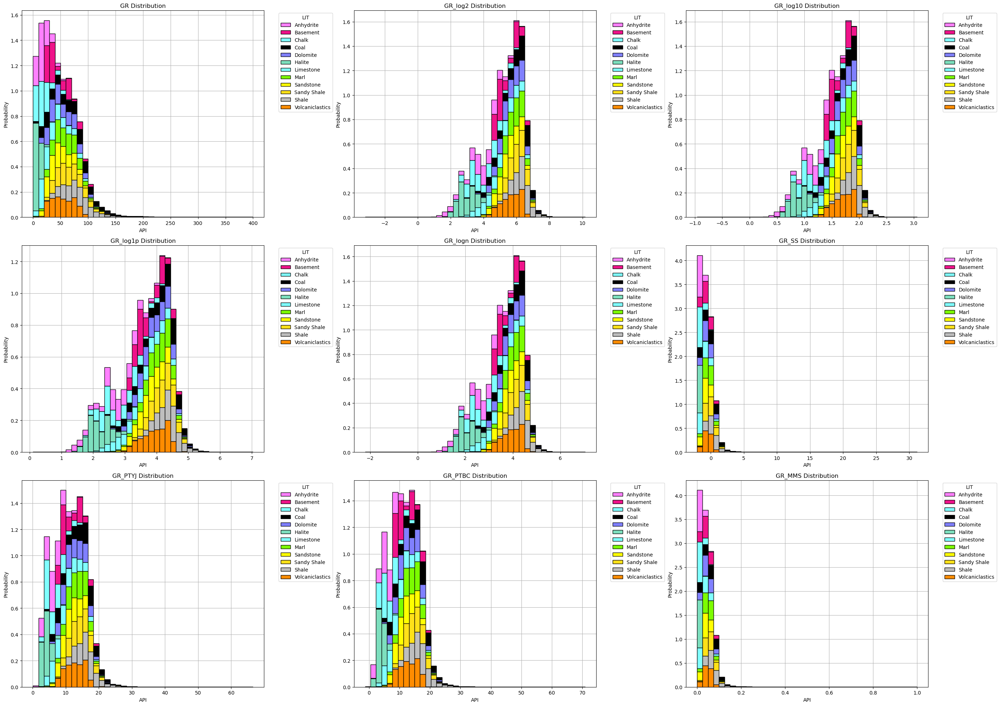

In [98]:
gr_curves=['GR', 'GR_log2', 'GR_log10', 'GR_log1p','GR_logn', 'GR_SS', 'GR_PTYJ', 'GR_PTBC', 'GR_MMS']
fig = plt.figure(figsize=(28,20))

for i, feature in enumerate(gr_curves):
    ax=fig.add_subplot(3,3,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
    fig.suptitle('')
    
    #ax=sns.histplot(data=well_log, x=feature, hue='LIT', stat='probability', multiple='stack', alpha=1, bins=40, binrange=(0,10),fill=True, log_scale=False, palette=litocolor, common_norm=False)
    #ax=sns.histplot(data=well_log, x=feature, hue='LIT', stat='probability', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
    #ax.set_xscale("linear")
    #ax.set_xscale("log")
    #ax.set_xlabel('API')
    
    if i==0:
        #well_log.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_log, x=feature, hue='LIT', stat='probability', multiple='stack', alpha=1, bins=40, binrange=(0,400), fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('API')
    
    else:
        #well_log.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        #ax=sns.histplot(data=well_log, x=feature, hue='LIT', stat='probability', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(800)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
        #ax.set_xscale("log")
        ax=sns.histplot(data=well_log, x=feature, hue='LIT', stat='probability', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('API')
    
    sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
    ax.grid()
#plt.subplots_adjust(top=0.95)
plt.subplots_adjust(hspace=0.15, wspace=0.5)

plt.tight_layout()
#plt.savefig('histogramlithology_stackprobability_triassicdata_new.png')
plt.show()

In [252]:
well_log10 = well.copy()
well_log10['RSHA_log10'] = well_log10['RSHA'].apply(lambda x: log10(x))
well_log10['RMED_log10'] = well_log10['RMED'].apply(lambda x: log10(x))
well_log10['RDEP_log10'] = well_log10['RDEP'].apply(lambda x: log10(x))
well_log10['RXO_log10'] = well_log10['RXO'].apply(lambda x: log10(x))
well_log10['RMIC_log10'] = well_log10['RMIC'].apply(lambda x: log10(x))
well_log10['GR_log10'] = well_log10['GR'].apply(lambda x: log10(x))
well_log10['SGR_log10'] = well_log10['SGR'].apply(lambda x: log10(x))
well_log10['PEF_log10'] = well_log10['PEF'].apply(lambda x: log10(x))
#well_log10.drop(['RSHA','RMED','RDEP', 'RXO', 'GR', 'PEF', 'SGR', 'RMIC'], axis=1, inplace=True)

In [254]:
well_logn = well.copy()
well_logn['RSHA_logn'] = well_logn['RSHA'].apply(lambda x: log(x))
well_logn['RMED_logn'] = well_logn['RMED'].apply(lambda x: log(x))
well_logn['RDEP_logn'] = well_logn['RDEP'].apply(lambda x: log(x))
well_logn['RXO_logn'] = well_logn['RXO'].apply(lambda x: log(x))
well_logn['RMIC_logn'] = well_logn['RMIC'].apply(lambda x: log(x))
well_logn['GR_logn'] = well_logn['GR'].apply(lambda x: log(x))
well_logn['SGR_logn'] = well_logn['SGR'].apply(lambda x: log(x))
well_logn['PEF_logn'] = well_logn['PEF'].apply(lambda x: log(x))
#well_logn.drop(['RSHA','RMED','RDEP', 'RXO', 'GR', 'PEF', 'SGR', 'RMIC'], axis=1, inplace=True)


In [14]:
well_logPTYJ = well.copy()
well_logPTYJ['RSHA_logPTYJ'] = pt_yj.fit_transform(well_logPTYJ[['RSHA']])
well_logPTYJ['RMED_logPTYJ'] = pt_yj.fit_transform(well_logPTYJ[['RMED']])
well_logPTYJ['RDEP_logPTYJ'] = pt_yj.fit_transform(well_logPTYJ[['RDEP']])
well_logPTYJ['RXO_logPTYJ'] = pt_yj.fit_transform(well_logPTYJ[['RXO']])
well_logPTYJ['RMIC_logPTYJ'] = pt_yj.fit_transform(well_logPTYJ[['RMIC']])
well_logPTYJ['GR_logPTYJ'] = pt_yj.fit_transform(well_logPTYJ[['GR']])
well_logPTYJ['SGR_logPTYJ'] = pt_yj.fit_transform(well_logPTYJ[['SGR']])
well_logPTYJ['PEF_logPTYJ'] = pt_yj.fit_transform(well_logPTYJ[['PEF']])
#well_logPTYJ.drop(['RSHA','RMED','RDEP', 'RXO', 'GR', 'PEF', 'SGR', 'RMIC'], axis=1, inplace=True)

In [256]:
well_log['GR_PTBC'] = pt_bc.fit_transform(well_log[['GR']])

well_logPTBC = well.copy()
well_logPTBC['RSHA_logPTBC'] = pt_bc.fit_transform(well_logPTBC[['RSHA']])
well_logPTBC['RMED_logPTBC'] = pt_bc.fit_transform(well_logPTBC[['RMED']])
well_logPTBC['RDEP_logPTBC'] = pt_bc.fit_transform(well_logPTBC[['RDEP']])
well_logPTBC['RXO_logPTBC'] = pt_bc.fit_transform(well_logPTBC[['RXO']])
well_logPTBC['RMIC_logPTBC'] = pt_bc.fit_transform(well_logPTBC[['RMIC']])
well_logPTBC['GR_logPTBC'] = pt_bc.fit_transform(well_logPTBC[['GR']])
well_logPTBC['SGR_logPTBC'] = pt_bc.fit_transform(well_logPTBC[['SGR']])
well_logPTBC['PEF_logPTBC'] = pt_bc.fit_transform(well_logPTBC[['PEF']])
#well_logPTBC.drop(['RSHA','RMED','RDEP', 'RXO', 'GR', 'PEF', 'SGR', 'RMIC'], axis=1, inplace=True)

## Well Correlation (Pearson)


### Linear correlation


In [105]:
#Histogram on each specific column for more detail
well_corr = well.copy()
well_corr.drop(['WELL','DEPTH','CALI','BS', 'DRHO','LITHOLOGY', 'GROUP', 'FORMATION', 'LIT', 'LITCOLOR'], axis=1, inplace=True)
well_corr

,RSHA,RMED,RDEP,RXO,RMIC,GR,SGR,NPHI,PEF,RHOB,SP,DTC,DTS
0,NaN,NaN,0.878615,NaN,NaN,103.451515,NaN,0.439925,NaN,NaN,NaN,147.043427,326.451263
1,NaN,NaN,0.874237,NaN,NaN,94.124893,NaN,0.504055,NaN,NaN,NaN,145.426468,322.926361
2,NaN,NaN,0.869858,NaN,NaN,93.586487,NaN,0.512960,NaN,NaN,NaN,145.295105,325.283142
3,NaN,NaN,0.865479,NaN,NaN,91.113373,NaN,0.500070,NaN,NaN,NaN,143.657593,334.233185
4,NaN,0.849849,0.863804,NaN,NaN,100.228333,NaN,0.277670,NaN,NaN,NaN,142.838440,330.952362
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1292903,525.196472,NaN,1399.928101,NaN,NaN,1.773538,NaN,0.126441,NaN,1.997159,NaN,69.353172,NaN
1292904,208.707199,NaN,1388.194702,NaN,NaN,1.408370,NaN,0.112439,NaN,2.012719,NaN,69.454887,NaN
1292905,89.526634,NaN,1376.633545,NaN,NaN,1.341022,NaN,0.104481,NaN,2.018507,NaN,69.518295,NaN
1292906,21.578579,NaN,1375.711182,NaN,NaN,1.273675,NaN,0.107911,NaN,2.005253,NaN,69.618744,NaN


In [106]:
correlate = well_corr.corr(method = 'pearson')
correlate

,RSHA,RMED,RDEP,RXO,RMIC,GR,SGR,NPHI,PEF,RHOB,SP,DTC,DTS
RSHA,1.000000,0.160279,0.279110,0.386561,0.155407,-0.078461,-0.014238,-0.155101,-0.011509,0.071752,-0.027991,-0.133226,-0.104817
RMED,0.160279,1.000000,0.172936,0.077398,0.049032,-0.017747,0.010892,-0.050281,0.052361,-0.003718,-0.019755,-0.095783,-0.107865
RDEP,0.279110,0.172936,1.000000,0.146951,0.046494,-0.123036,-0.004638,-0.174234,-0.005508,-0.037563,-0.020157,-0.124172,-0.093584
RXO,0.386561,0.077398,0.146951,1.000000,0.333932,-0.042365,-0.016084,-0.090945,0.008471,0.041208,0.014768,-0.076327,-0.184158
RMIC,0.155407,0.049032,0.046494,0.333932,1.000000,-0.019807,-0.066772,-0.043278,-0.021177,0.056940,0.017231,-0.059283,-0.145858
GR,-0.078461,-0.017747,-0.123036,-0.042365,-0.019807,1.000000,0.585147,0.237103,-0.077988,0.151656,0.093000,0.052191,0.116663
SGR,-0.014238,0.010892,-0.004638,-0.016084,-0.066772,0.585147,1.000000,0.178179,0.063748,0.018022,0.123715,0.118693,0.168189
NPHI,-0.155101,-0.050281,-0.174234,-0.090945,-0.043278,0.237103,0.178179,1.000000,0.022193,-0.632356,-0.124492,0.792142,0.750116
PEF,-0.011509,0.052361,-0.005508,0.008471,-0.021177,-0.077988,0.063748,0.022193,1.000000,-0.099220,-0.003342,0.022905,-0.016490
RHOB,0.071752,-0.003718,-0.037563,0.041208,0.056940,0.151656,0.018022,-0.632356,-0.099220,1.000000,0.076907,-0.818009,-0.717091


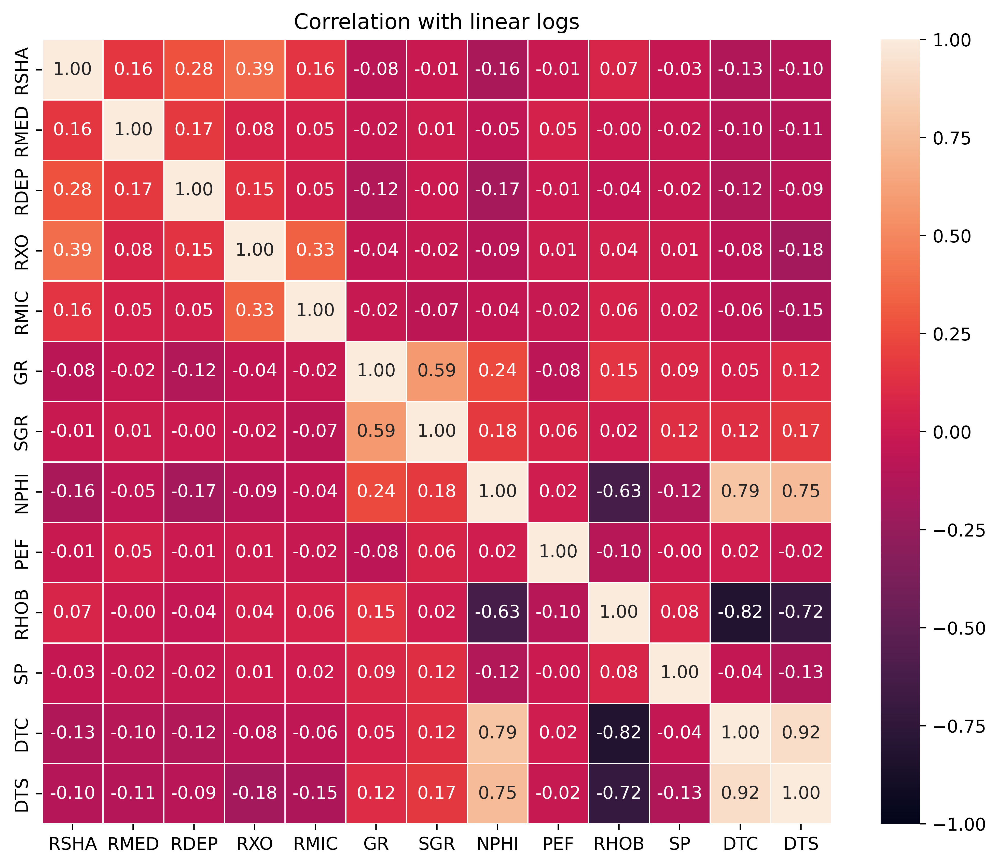

In [107]:
plt.figure(figsize=(10,8), dpi =500)
sns.heatmap(correlate,annot=True,fmt=".2f", vmin=-1, vmax=1, linewidth=.5)
plt.title("Correlation with linear logs")
plt.show()

### Log-lin correlation (with log10)


In [253]:
#Histogram on each specific column for more detail
well_corr10 = well_log10.copy()
well_corr10.drop(['RSHA','RMED','RDEP', 'RXO', 'GR', 'PEF', 'SGR', 'RMIC'], axis=1, inplace=True)
well_corr10.drop(['WELL','DEPTH','CALI','BS', 'DRHO','LITHOLOGY', 'GROUP', 'FORMATION', 'LIT', 'LITCOLOR'], axis=1, inplace=True)
well_corr10

,NPHI,RHOB,SP,DTC,DTS,RSHA_log10,RMED_log10,RDEP_log10,RXO_log10,RMIC_log10,GR_log10,SGR_log10,PEF_log10
0,0.439925,NaN,NaN,147.043427,326.451263,NaN,NaN,-0.056201,NaN,NaN,2.014737,NaN,NaN
1,0.504055,NaN,NaN,145.426468,322.926361,NaN,NaN,-0.058371,NaN,NaN,1.973704,NaN,NaN
2,0.512960,NaN,NaN,145.295105,325.283142,NaN,NaN,-0.060552,NaN,NaN,1.971213,NaN,NaN
3,0.500070,NaN,NaN,143.657593,334.233185,NaN,NaN,-0.062743,NaN,NaN,1.959582,NaN,NaN
4,0.277670,NaN,NaN,142.838440,330.952362,NaN,-0.070658,-0.063585,NaN,NaN,2.000991,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1292903,0.126441,1.997159,NaN,69.353172,NaN,2.720322,NaN,3.146106,NaN,NaN,0.248841,NaN,NaN
1292904,0.112439,2.012719,NaN,69.454887,NaN,2.319537,NaN,3.142450,NaN,NaN,0.148717,NaN,NaN
1292905,0.104481,2.018507,NaN,69.518295,NaN,1.951952,NaN,3.138818,NaN,NaN,0.127436,NaN,NaN
1292906,0.107911,2.005253,NaN,69.618744,NaN,1.334023,NaN,3.138527,NaN,NaN,0.105059,NaN,NaN


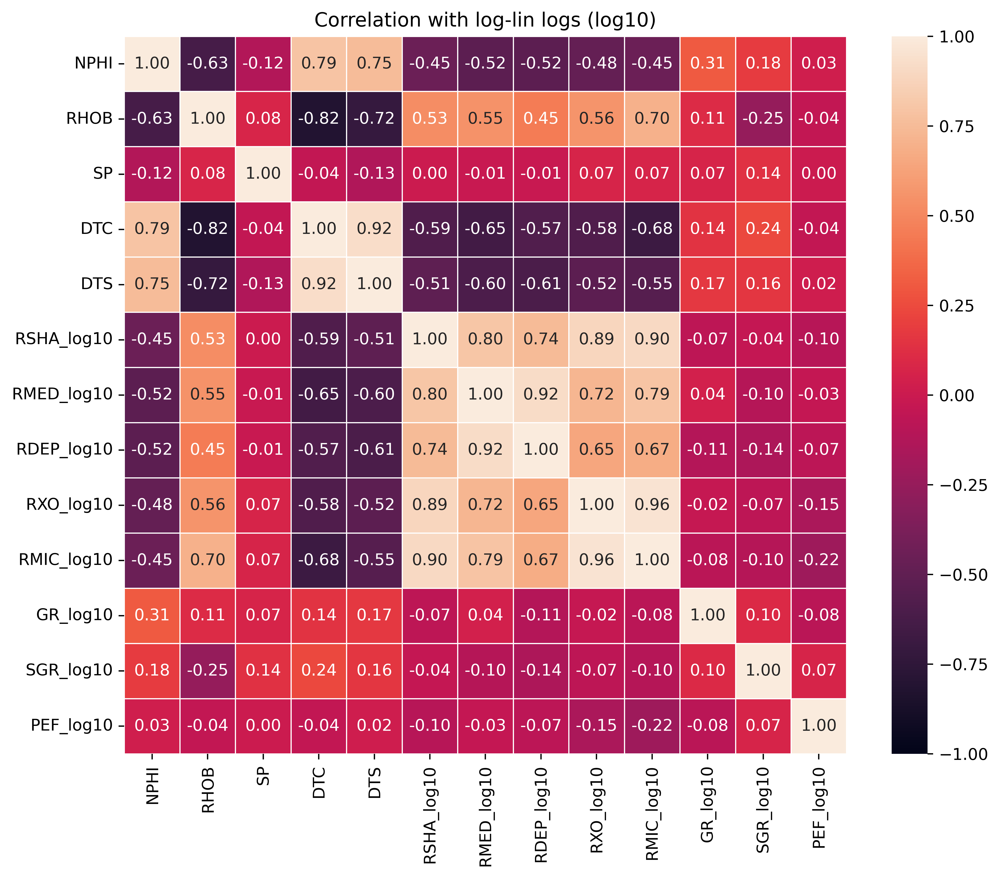

In [109]:
correlate_log10 = well_corr10.corr(method = 'pearson')
plt.figure(figsize=(10,8), dpi =500)
sns.heatmap(correlate_log10,annot=True,fmt=".2f", vmin=-1, vmax=1, linewidth=.5)
plt.title("Correlation with log-lin logs (log10)")
plt.show()

### Log-lin correlation (with logn)

In [110]:
#Histogram on each specific column for more detail
well_corrn = well_logn.copy()
well_corrn.drop(['RSHA','RMED','RDEP', 'RXO', 'GR', 'PEF', 'SGR', 'RMIC'], axis=1, inplace=True)
well_corrn.drop(['WELL','DEPTH','CALI','BS', 'DRHO','LITHOLOGY', 'GROUP', 'FORMATION', 'LIT', 'LITCOLOR'], axis=1, inplace=True)
well_corrn

,NPHI,RHOB,SP,DTC,DTS,RSHA_logn,RMED_logn,RDEP_logn,RXO_logn,RMIC_logn,GR_logn,SGR_logn,PEF_logn
0,0.439925,NaN,NaN,147.043427,326.451263,NaN,NaN,-0.129408,NaN,NaN,4.639103,NaN,NaN
1,0.504055,NaN,NaN,145.426468,322.926361,NaN,NaN,-0.134404,NaN,NaN,4.544623,NaN,NaN
2,0.512960,NaN,NaN,145.295105,325.283142,NaN,NaN,-0.139425,NaN,NaN,4.538886,NaN,NaN
3,0.500070,NaN,NaN,143.657593,334.233185,NaN,NaN,-0.144472,NaN,NaN,4.512105,NaN,NaN
4,0.277670,NaN,NaN,142.838440,330.952362,NaN,-0.162697,-0.146410,NaN,NaN,4.607451,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1292903,0.126441,1.997159,NaN,69.353172,NaN,6.263772,NaN,7.244176,NaN,NaN,0.572977,NaN,NaN
1292904,0.112439,2.012719,NaN,69.454887,NaN,5.340932,NaN,7.235759,NaN,NaN,0.342433,NaN,NaN
1292905,0.104481,2.018507,NaN,69.518295,NaN,4.494536,NaN,7.227396,NaN,NaN,0.293432,NaN,NaN
1292906,0.107911,2.005253,NaN,69.618744,NaN,3.071701,NaN,7.226726,NaN,NaN,0.241906,NaN,NaN


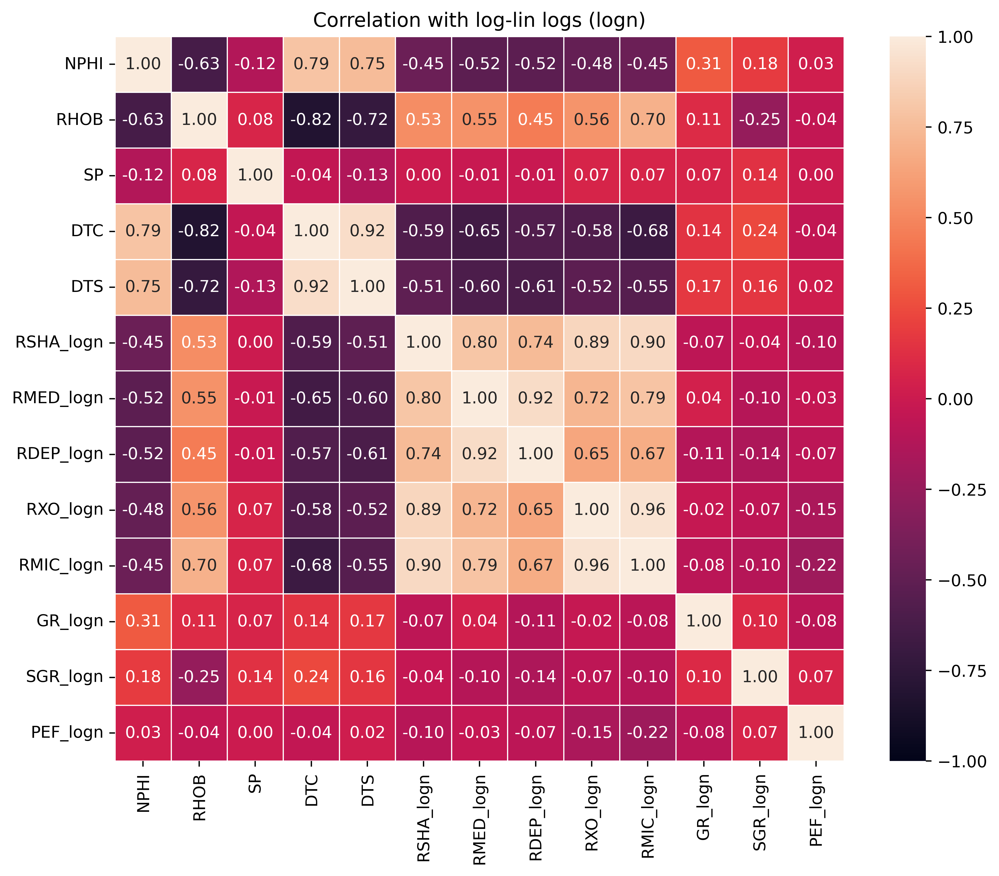

In [111]:
correlate_logn = well_corrn.corr(method = 'pearson')
plt.figure(figsize=(10,8), dpi =500)
sns.heatmap(correlate_logn,annot=True,fmt=".2f", vmin=-1, vmax=1, linewidth=.5)
plt.title("Correlation with log-lin logs (logn)")
plt.show()

### Log-lin correlation (with PowerTransform yeo-johnson)

In [118]:
#Histogram on each specific column for more detail
well_corrptyj = well_logPTYJ.copy()
well_corrptyj.drop(['RSHA','RMED','RDEP', 'RXO', 'GR', 'PEF', 'SGR', 'RMIC'], axis=1, inplace=True)
well_corrptyj.drop(['WELL','DEPTH','CALI','BS', 'DRHO','LITHOLOGY', 'GROUP', 'FORMATION', 'LIT', 'LITCOLOR'], axis=1, inplace=True)
well_corrptyj

,NPHI,RHOB,SP,DTC,DTS,RSHA_logPTYJ,RMED_logPTYJ,RDEP_logPTYJ,RXO_logPTYJ,RMIC_logPTYJ,GR_logPTYJ,SGR_logPTYJ,PEF_logPTYJ
0,0.439925,NaN,NaN,147.043427,326.451263,NaN,NaN,0.465439,NaN,NaN,18.609550,NaN,NaN
1,0.504055,NaN,NaN,145.426468,322.926361,NaN,NaN,0.464209,NaN,NaN,17.663113,NaN,NaN
2,0.512960,NaN,NaN,145.295105,325.283142,NaN,NaN,0.462973,NaN,NaN,17.607098,NaN,NaN
3,0.500070,NaN,NaN,143.657593,334.233185,NaN,NaN,0.461731,NaN,NaN,17.347739,NaN,NaN
4,0.277670,NaN,NaN,142.838440,330.952362,NaN,0.45277,0.461254,NaN,NaN,18.287410,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1292903,0.126441,1.997159,NaN,69.353172,NaN,1.115611,NaN,0.982541,NaN,NaN,1.332923,NaN,NaN
1292904,0.112439,2.012719,NaN,69.454887,NaN,1.110311,NaN,0.982536,NaN,NaN,1.105293,NaN,NaN
1292905,0.104481,2.018507,NaN,69.518295,NaN,1.099742,NaN,0.982530,NaN,NaN,1.061479,NaN,NaN
1292906,0.107911,2.005253,NaN,69.618744,NaN,1.050552,NaN,0.982530,NaN,NaN,1.017033,NaN,NaN


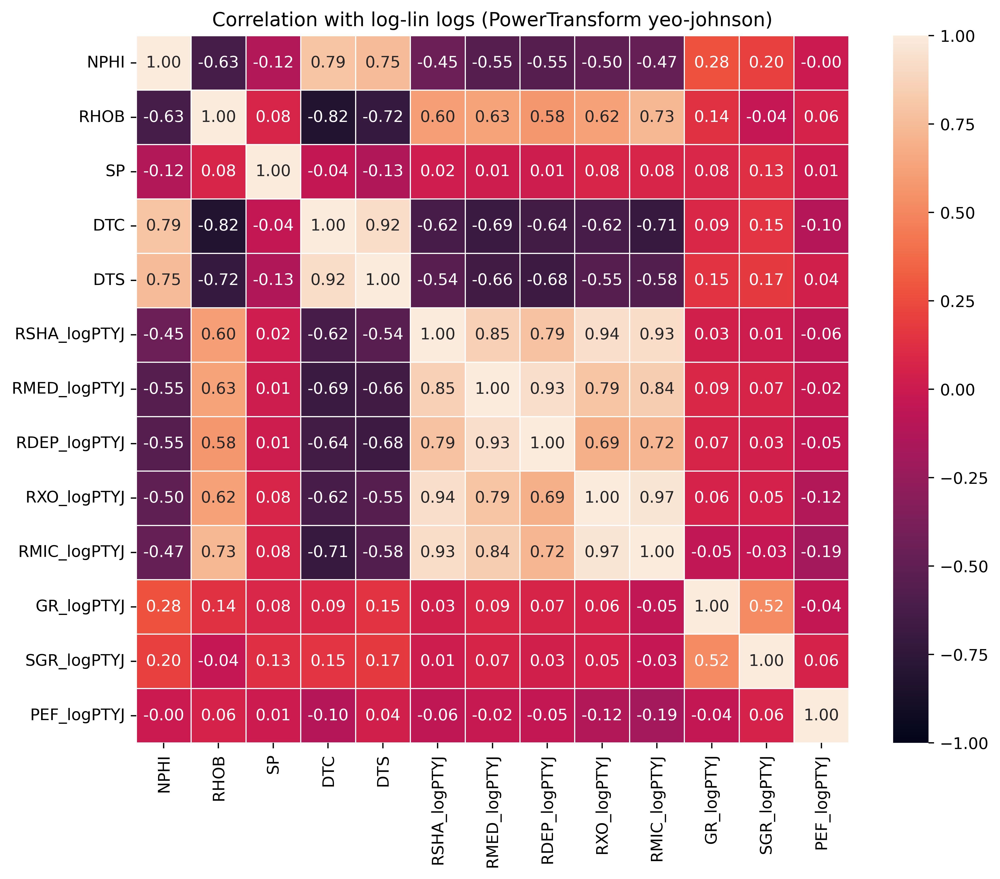

In [119]:
correlate_logptyj = well_corrptyj.corr(method = 'pearson')
plt.figure(figsize=(10,8), dpi =500)
sns.heatmap(correlate_logptyj,annot=True,fmt=".2f", vmin=-1, vmax=1, linewidth=.5)
plt.title("Correlation with log-lin logs (PowerTransform yeo-johnson)")
plt.show()

### Log-lin correlation (with PowerTransform box-cox)

In [120]:
#Histogram on each specific column for more detail
well_corrptbc = well_logPTBC.copy()
well_corrptbc.drop(['RSHA','RMED','RDEP', 'RXO', 'GR', 'PEF', 'SGR', 'RMIC'], axis=1, inplace=True)
well_corrptbc.drop(['WELL','DEPTH','CALI','BS', 'DRHO','LITHOLOGY', 'GROUP', 'FORMATION', 'LIT', 'LITCOLOR'], axis=1, inplace=True)
well_corrptbc

,NPHI,RHOB,SP,DTC,DTS,RSHA_logPTBC,RMED_logPTBC,RDEP_logPTBC,RXO_logPTBC,RMIC_logPTBC,GR_logPTBC,SGR_logPTBC,PEF_logPTBC
0,0.439925,NaN,NaN,147.043427,326.451263,NaN,NaN,-0.133287,NaN,NaN,19.217900,NaN,NaN
1,0.504055,NaN,NaN,145.426468,322.926361,NaN,NaN,-0.138591,NaN,NaN,18.213350,NaN,NaN
2,0.512960,NaN,NaN,145.295105,325.283142,NaN,NaN,-0.143935,NaN,NaN,18.153916,NaN,NaN
3,0.500070,NaN,NaN,143.657593,334.233185,NaN,NaN,-0.149317,NaN,NaN,17.878756,NaN,NaN
4,0.277670,NaN,NaN,142.838440,330.952362,NaN,-0.168455,-0.151387,NaN,NaN,18.875907,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1292903,0.126441,1.997159,NaN,69.353172,NaN,3.329785,NaN,2.119792,NaN,NaN,0.666437,NaN,NaN
1292904,0.112439,2.012719,NaN,69.454887,NaN,3.084351,NaN,2.119478,NaN,NaN,0.374469,NaN,NaN
1292905,0.104481,2.018507,NaN,69.518295,NaN,2.808883,NaN,2.119165,NaN,NaN,0.316754,NaN,NaN
1292906,0.107911,2.005253,NaN,69.618744,NaN,2.206990,NaN,2.119139,NaN,NaN,0.257614,NaN,NaN


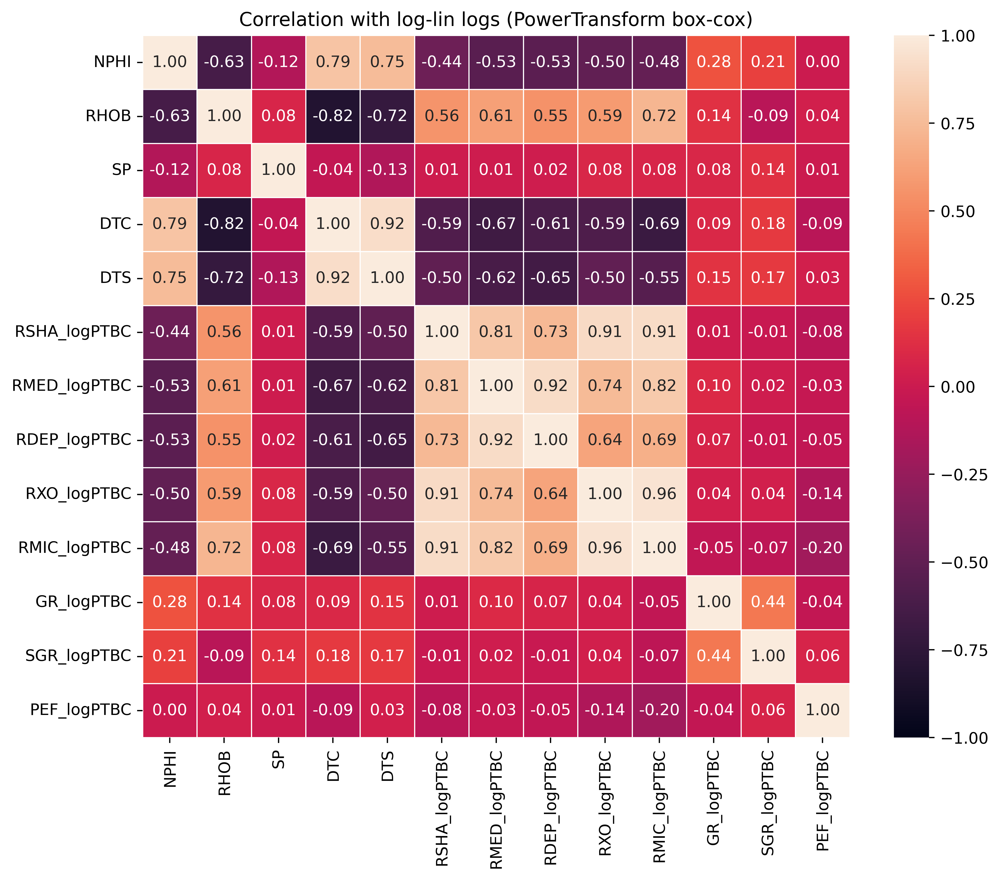

In [121]:
correlate_logptbc = well_corrptbc.corr(method = 'pearson')
plt.figure(figsize=(10,8), dpi =500)
sns.heatmap(correlate_logptbc,annot=True,fmt=".2f", vmin=-1, vmax=1, linewidth=.5)
plt.title("Correlation with log-lin logs (PowerTransform box-cox)")
plt.show()

### Other correlation method (not used)

In [6]:
correlate.style.background_gradient(cmap='coolwarm')

,RSHA,RMED,RDEP,RXO,GR,NPHI,PEF,RHOB,SP,DRHO,DTC,DTS
RSHA,1.000000,0.710685,0.264214,0.486955,-0.078275,-0.204405,-0.022774,0.152684,0.017601,-0.006304,-0.168418,-0.245550
RMED,0.710685,1.000000,0.258480,0.548903,-0.015455,-0.129534,-0.014131,0.121404,-0.044824,-0.015588,-0.125921,-0.314113
RDEP,0.264214,0.258480,1.000000,0.295914,-0.018742,-0.147543,-0.034600,0.139001,-0.041304,-0.007029,-0.141162,-0.308186
RXO,0.486955,0.548903,0.295914,1.000000,-0.095293,-0.235153,-0.027397,0.217095,-0.049602,-0.058978,-0.193280,-0.243221
GR,-0.078275,-0.015455,-0.018742,-0.095293,1.000000,0.189393,-0.077946,0.166823,0.101751,0.065643,-0.086132,0.006761
NPHI,-0.204405,-0.129534,-0.147543,-0.235153,0.189393,1.000000,0.101950,-0.781076,0.164258,0.108715,0.849965,0.787004
PEF,-0.022774,-0.014131,-0.034600,-0.027397,-0.077946,0.101950,1.000000,-0.121898,-0.017377,-0.170756,0.094910,0.127298
RHOB,0.152684,0.121404,0.139001,0.217095,0.166823,-0.781076,-0.121898,1.000000,-0.198939,-0.028458,-0.846873,-0.755457
SP,0.017601,-0.044824,-0.041304,-0.049602,0.101751,0.164258,-0.017377,-0.198939,1.000000,-0.029017,0.159628,0.023730
DRHO,-0.006304,-0.015588,-0.007029,-0.058978,0.065643,0.108715,-0.170756,-0.028458,-0.029017,1.000000,-0.000447,0.290644


## Dendogram for Hierarchical Clustering


### Linear dendogram


In [140]:
def link_dissimilarity (correlate):
    dissimilarity = 1 - abs(correlate)
    z = linkage(squareform(dissimilarity), 'complete')
    
    return z

Text(0.5, 1.0, 'Dendogram of linear logs')

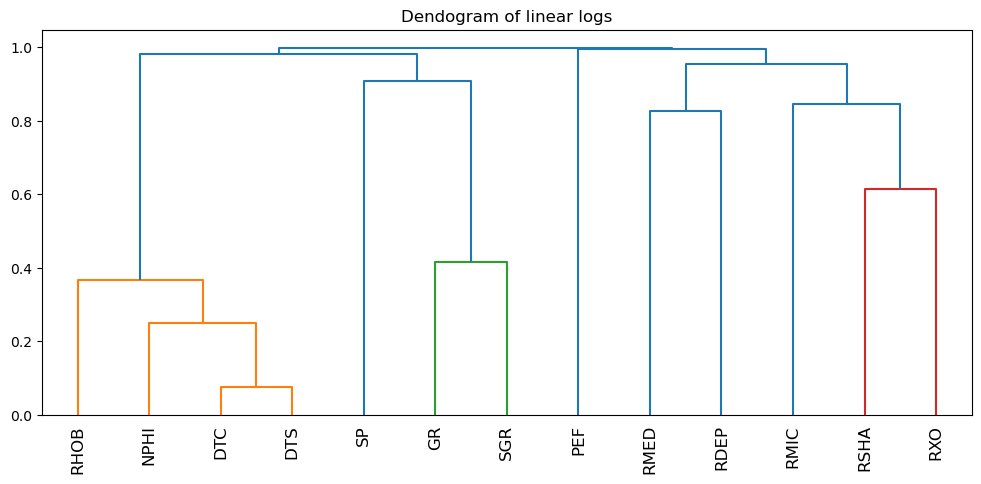

In [141]:
z = link_dissimilarity(correlate)

plt.figure(figsize=(12,5))
dendrogram(z, labels=well_corr.columns, orientation='top', 
           leaf_rotation=90);
plt.title("Dendogram of linear logs")

In [143]:
def dendogram_cluster (z, well_data):
    # Clusterize the data
    threshold = 0.8
    labels = fcluster(z, threshold, criterion='distance')

    # Keep the indices to sort labels
    labels_order = np.argsort(labels)

    # Build a new dataframe with the sorted columns
    for idx, i in enumerate(well_data.columns[labels_order]):
        if idx == 0:
            clustered = pd.DataFrame(well_data[i])
        else:
            df_to_append = pd.DataFrame(well_data[i])
            clustered = pd.concat([clustered, df_to_append], axis=1)
    
    return clustered

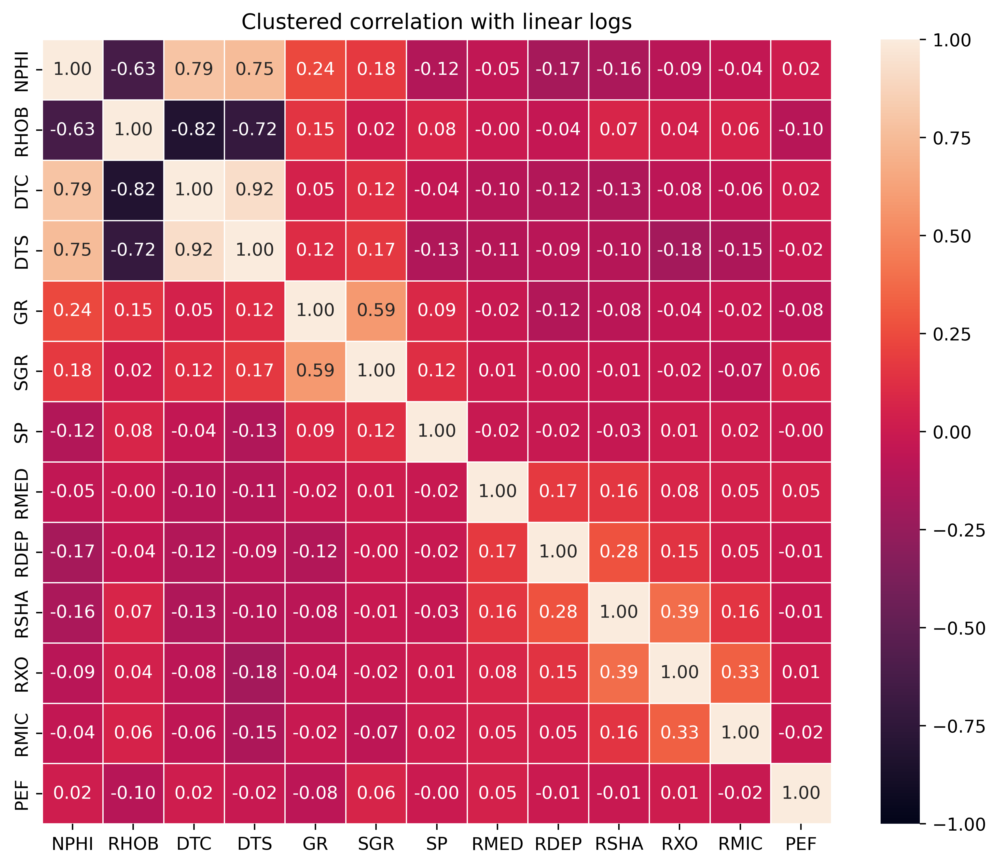

In [144]:
clustered = dendogram_cluster(z, well_corr)
correlate_clustered = clustered.corr()

plt.figure(figsize=(10,8), dpi =500)
sns.heatmap(correlate_clustered,annot=True,fmt=".2f", vmin=-1, vmax=1, linewidth=.5)
plt.title("Clustered correlation with linear logs")
plt.show()

### Log-lin dendogram (log10)


Text(0.5, 1.0, 'Dendogram of log-lin logs (log10)')

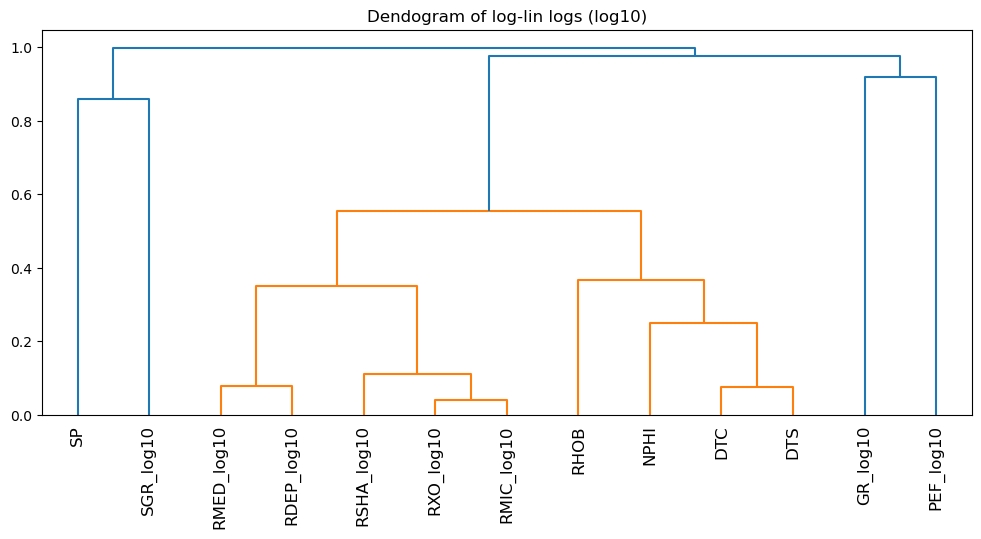

In [145]:
z_log10 = link_dissimilarity(correlate_log10)

plt.figure(figsize=(12,5))
dendrogram(z_log10, labels=well_corr10.columns, orientation='top', 
           leaf_rotation=90);
plt.title("Dendogram of log-lin logs (log10)")

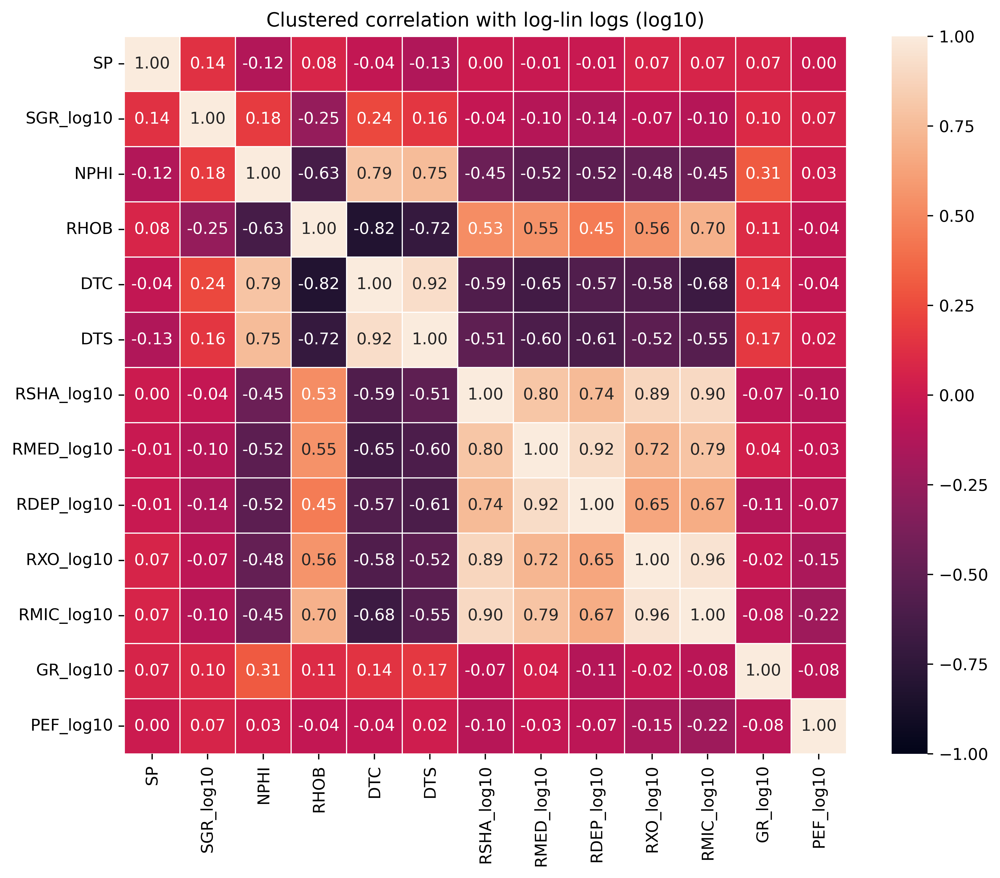

In [146]:
clustered_log10 = dendogram_cluster(z_log10, well_corr10)
correlate_clustered_log10 = clustered_log10.corr()

plt.figure(figsize=(10,8), dpi =500)
sns.heatmap(correlate_clustered_log10,annot=True,fmt=".2f", vmin=-1, vmax=1, linewidth=.5)
plt.title("Clustered correlation with log-lin logs (log10)")
plt.show()

### Log-lin dendogram (logn)

Text(0.5, 1.0, 'Dendogram of log-lin logs (logn)')

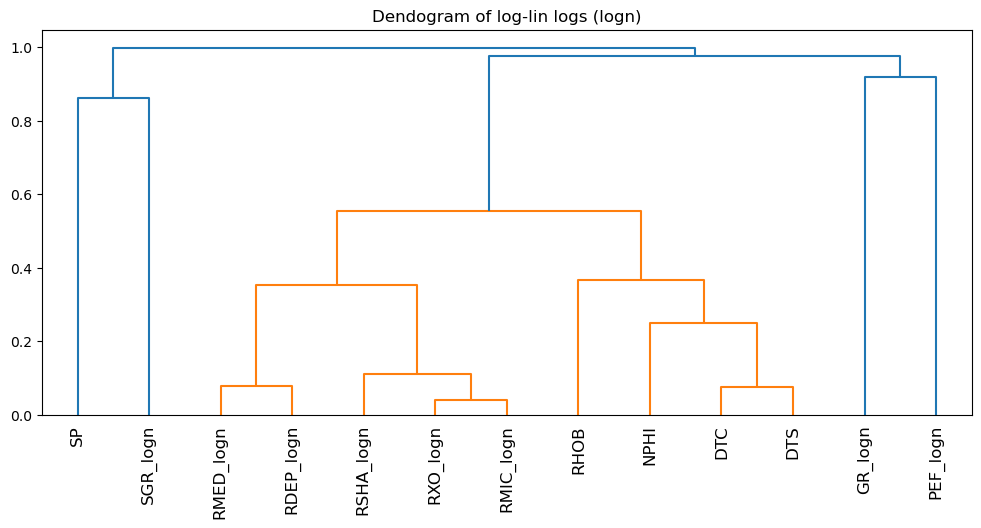

In [147]:
z_logn = link_dissimilarity(correlate_logn)

plt.figure(figsize=(12,5))
dendrogram(z_logn, labels=well_corrn.columns, orientation='top', 
           leaf_rotation=90);
plt.title("Dendogram of log-lin logs (logn)")

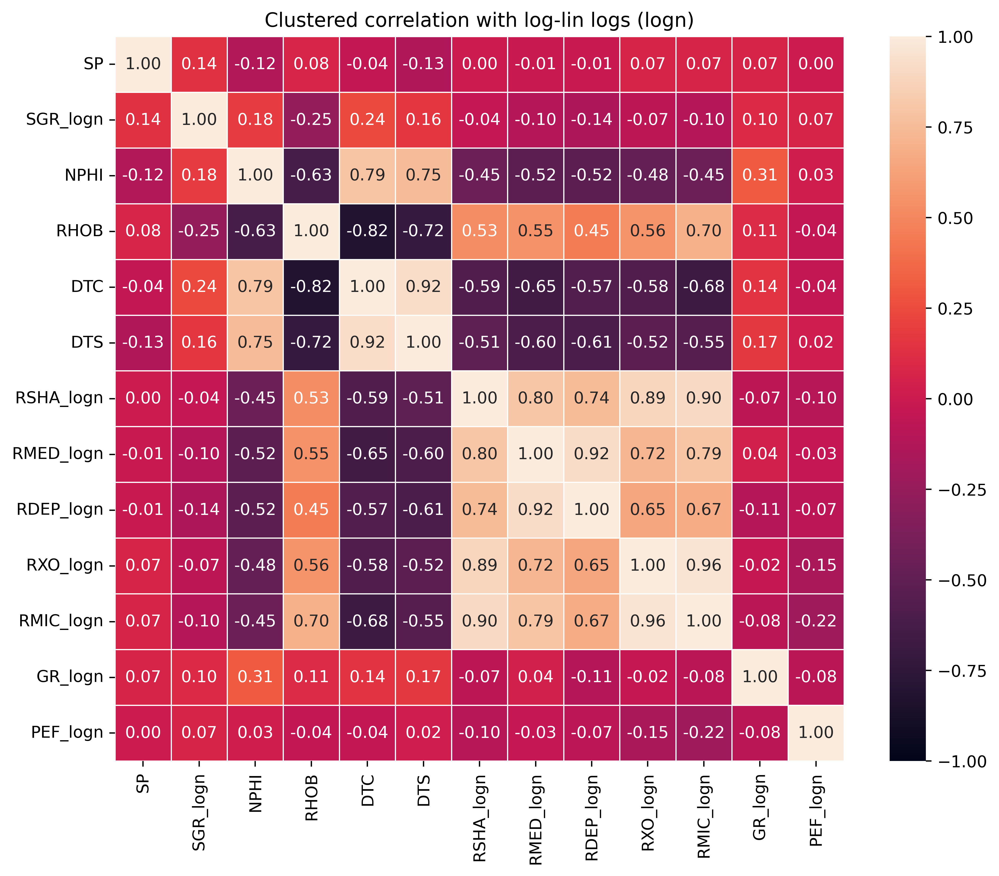

In [148]:
clustered_logn = dendogram_cluster(z_logn, well_corrn)
correlate_clustered_logn = clustered_logn.corr()

plt.figure(figsize=(10,8), dpi =500)
sns.heatmap(correlate_clustered_logn,annot=True,fmt=".2f", vmin=-1, vmax=1, linewidth=.5)
plt.title("Clustered correlation with log-lin logs (logn)")
plt.show()

### Log-lin dendogram (PowerTransform yeo-johnson)

Text(0.5, 1.0, 'Dendogram of log-lin logs (PowerTransform yeo-johnson)')

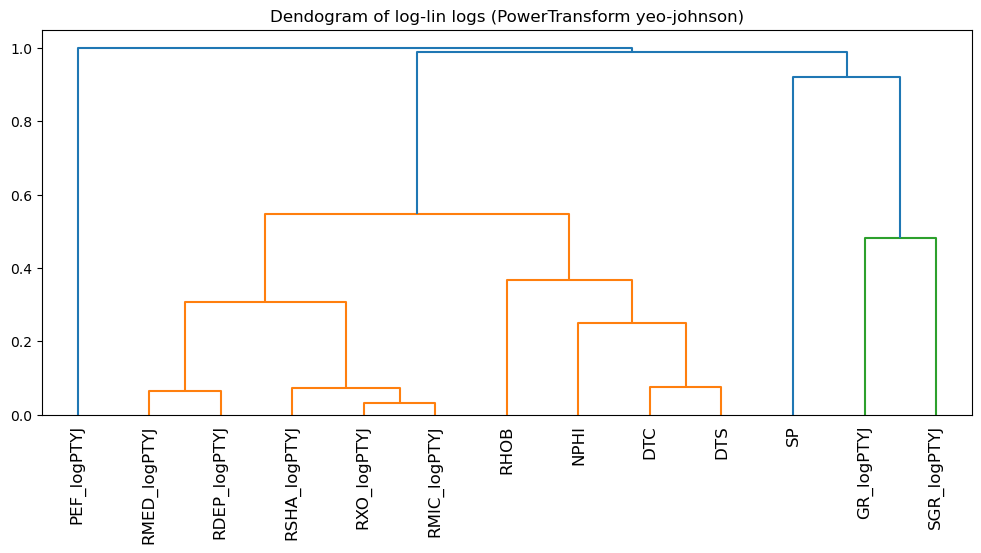

In [149]:
z_logptyj = link_dissimilarity(correlate_logptyj)

plt.figure(figsize=(12,5))
dendrogram(z_logptyj, labels=well_corrptyj.columns, orientation='top', 
           leaf_rotation=90);
plt.title("Dendogram of log-lin logs (PowerTransform yeo-johnson)")

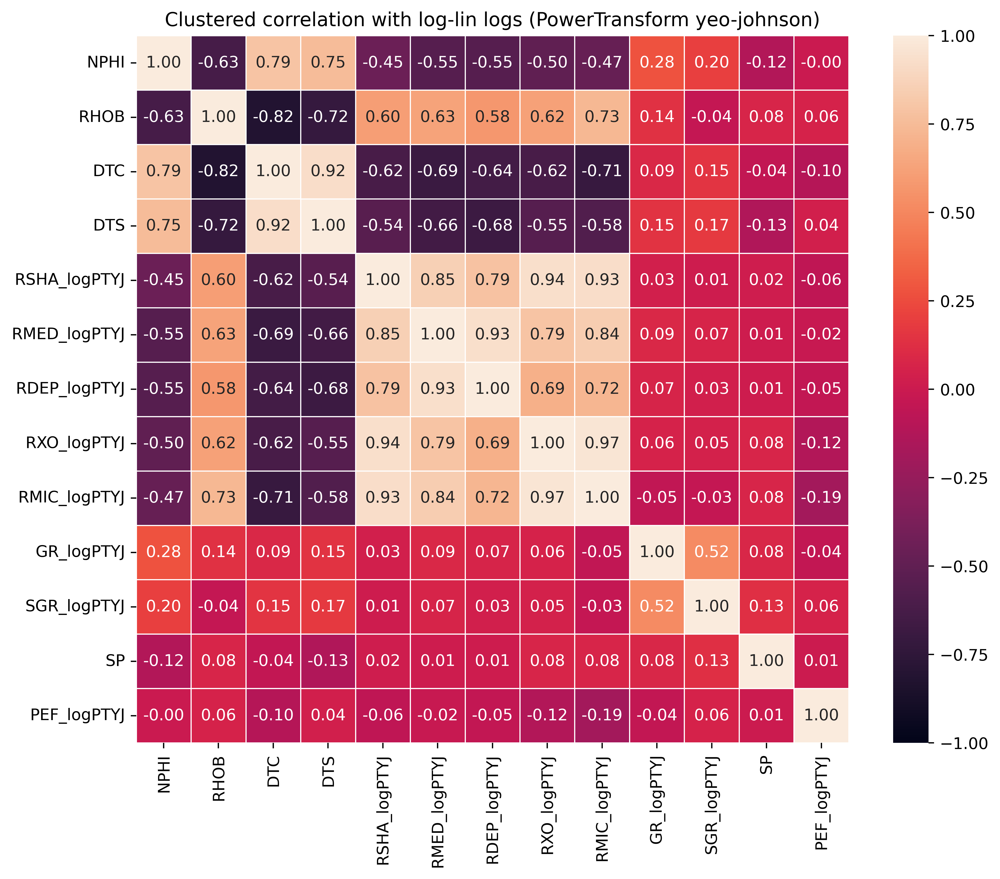

In [150]:
clustered_logptyj = dendogram_cluster(z_logptyj, well_corrptyj)
correlate_clustered_logptyj = clustered_logptyj.corr()

plt.figure(figsize=(10,8), dpi =500)
sns.heatmap(correlate_clustered_logptyj,annot=True,fmt=".2f", vmin=-1, vmax=1, linewidth=.5)
plt.title("Clustered correlation with log-lin logs (PowerTransform yeo-johnson)")
plt.show()

### Log-lin dendogram (PowerTransform box-cox)

Text(0.5, 1.0, 'Dendogram of log-lin logs (PowerTransform box-cox)')

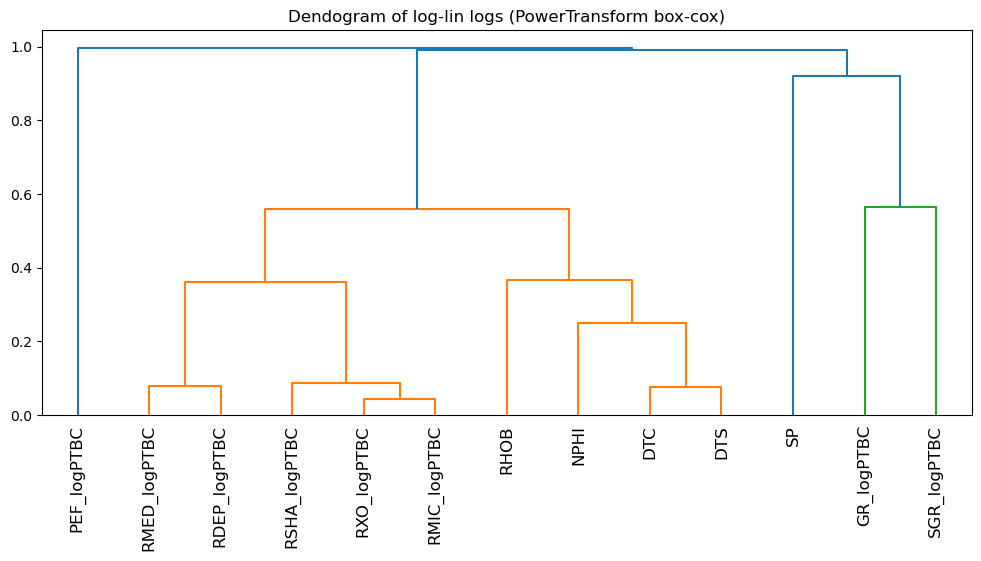

In [151]:
z_logptbc = link_dissimilarity(correlate_logptbc)

plt.figure(figsize=(12,5))
dendrogram(z_logptbc, labels=well_corrptbc.columns, orientation='top', 
           leaf_rotation=90);
plt.title("Dendogram of log-lin logs (PowerTransform box-cox)")

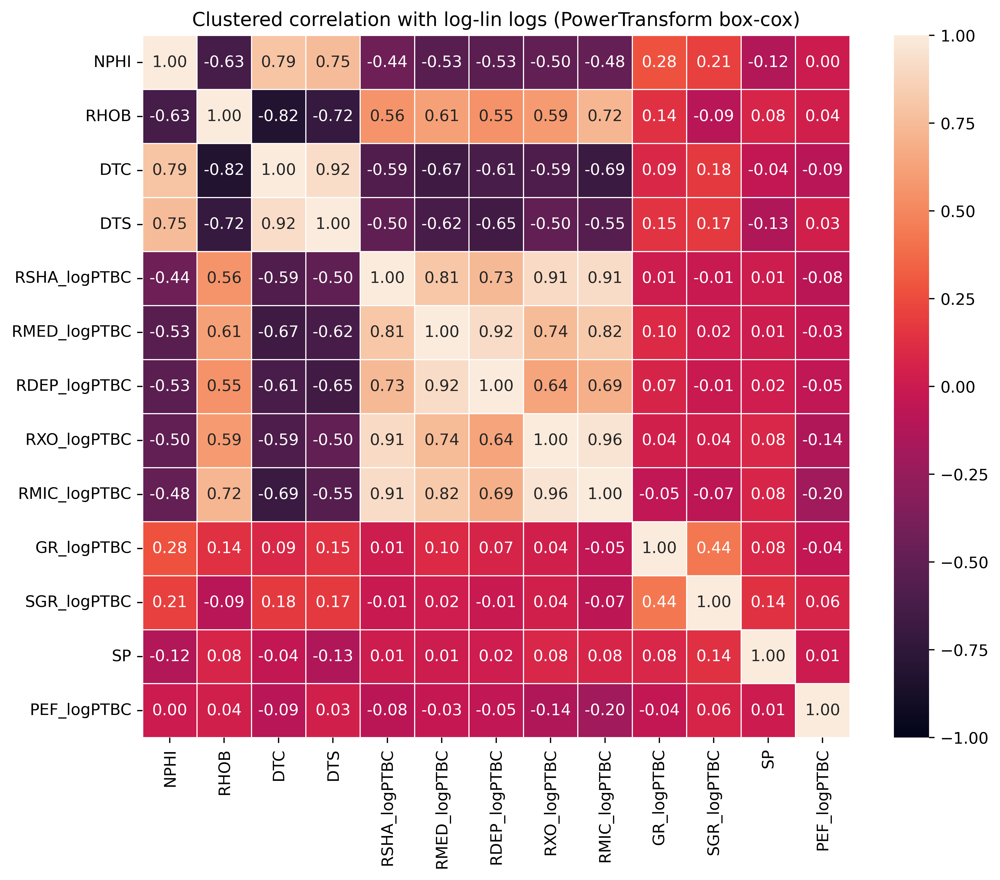

In [152]:
clustered_logptbc = dendogram_cluster(z_logptbc, well_corrptbc)
correlate_clustered_logptbc = clustered_logptbc.corr()

plt.figure(figsize=(10,8), dpi =500)
sns.heatmap(correlate_clustered_logptbc,annot=True,fmt=".2f", vmin=-1, vmax=1, linewidth=.5)
plt.title("Clustered correlation with log-lin logs (PowerTransform box-cox)")
plt.show()

## k-means Clustering

### Data Initiation

Based on Pearson and dendogram analysis, well log data that normalized with PowerTransform yeo-johnson gives the best result and correlation.

In [15]:
well_clustered = well_logPTYJ.copy()
well_clustered

,WELL,DEPTH,CALI,RSHA,RMED,RDEP,RXO,RMIC,GR,SGR,...,LIT,LITCOLOR,RSHA_logPTYJ,RMED_logPTYJ,RDEP_logPTYJ,RXO_logPTYJ,RMIC_logPTYJ,GR_logPTYJ,SGR_logPTYJ,PEF_logPTYJ
0,15/9-23,1518.280000,15.506232,NaN,NaN,0.878615,NaN,NaN,103.451515,NaN,...,Shale,#bebebe,NaN,NaN,0.465439,NaN,NaN,18.609550,NaN,NaN
1,15/9-23,1518.432000,18.524611,NaN,NaN,0.874237,NaN,NaN,94.124893,NaN,...,Shale,#bebebe,NaN,NaN,0.464209,NaN,NaN,17.663113,NaN,NaN
2,15/9-23,1518.584000,18.855669,NaN,NaN,0.869858,NaN,NaN,93.586487,NaN,...,Shale,#bebebe,NaN,NaN,0.462973,NaN,NaN,17.607098,NaN,NaN
3,15/9-23,1518.736000,19.163353,NaN,NaN,0.865479,NaN,NaN,91.113373,NaN,...,Shale,#bebebe,NaN,NaN,0.461731,NaN,NaN,17.347739,NaN,NaN
4,15/9-23,1518.888000,18.489744,NaN,0.849849,0.863804,NaN,NaN,100.228333,NaN,...,Shale,#bebebe,NaN,0.45277,0.461254,NaN,NaN,18.287410,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1292903,17/11-1,3237.857016,12.248030,525.196472,NaN,1399.928101,NaN,NaN,1.773538,NaN,...,Halite,#7ddfbe,1.115611,NaN,0.982541,NaN,NaN,1.332923,NaN,NaN
1292904,17/11-1,3238.009016,12.252416,208.707199,NaN,1388.194702,NaN,NaN,1.408370,NaN,...,Halite,#7ddfbe,1.110311,NaN,0.982536,NaN,NaN,1.105293,NaN,NaN
1292905,17/11-1,3238.161016,12.256806,89.526634,NaN,1376.633545,NaN,NaN,1.341022,NaN,...,Halite,#7ddfbe,1.099742,NaN,0.982530,NaN,NaN,1.061479,NaN,NaN
1292906,17/11-1,3238.313016,12.262195,21.578579,NaN,1375.711182,NaN,NaN,1.273675,NaN,...,Halite,#7ddfbe,1.050552,NaN,0.982530,NaN,NaN,1.017033,NaN,NaN


In [16]:
well_clustered.isnull().sum()

WELL                  0
DEPTH                 0
CALI              91320
RSHA             636575
RMED              48817
RDEP              11026
RXO              991199
RMIC            1101567
GR                    0
SGR             1222455
NPHI             430939
PEF              520777
RHOB             170797
SP               382338
BS               535762
DRHO             192785
DTC               84969
DTS             1045424
LITHOLOGY             0
GROUP                 0
FORMATION             0
LIT                   0
LITCOLOR              0
RSHA_logPTYJ     636575
RMED_logPTYJ      48817
RDEP_logPTYJ      11026
RXO_logPTYJ      991199
RMIC_logPTYJ    1101567
GR_logPTYJ            0
SGR_logPTYJ     1222455
PEF_logPTYJ      520777
dtype: int64

In [17]:
well_clustered.columns

Index(['WELL', 'DEPTH', 'CALI', 'RSHA', 'RMED', 'RDEP', 'RXO', 'RMIC', 'GR',
       'SGR', 'NPHI', 'PEF', 'RHOB', 'SP', 'BS', 'DRHO', 'DTC', 'DTS',
       'LITHOLOGY', 'GROUP', 'FORMATION', 'LIT', 'LITCOLOR', 'RSHA_logPTYJ',
       'RMED_logPTYJ', 'RDEP_logPTYJ', 'RXO_logPTYJ', 'RMIC_logPTYJ',
       'GR_logPTYJ', 'SGR_logPTYJ', 'PEF_logPTYJ'],
      dtype='object')

In [18]:
well_clustered = well_clustered[['WELL', 'DEPTH','GR_logPTYJ', 'RDEP_logPTYJ', 'PEF_logPTYJ', 
                                 'NPHI', 'RHOB', 'SP', 'DTC', 'CALI', 'GR', 'RDEP', 'PEF',
                                 'LITHOLOGY', 'GROUP', 'FORMATION', 'LIT', 'LITCOLOR']]

well_clustered.rename(columns = {'RDEP_logPTYJ':'RDEP_log'}, inplace = True)
well_clustered.rename(columns = {'GR_logPTYJ':'GR_log'}, inplace = True)
well_clustered.rename(columns = {'PEF_logPTYJ':'PEF_log'}, inplace = True)

well_clustered

C:\Users\V330\AppData\Local\Temp\ipykernel_23784\3090004759.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  well_clustered.rename(columns = {'RDEP_logPTYJ':'RDEP_log'}, inplace = True)
C:\Users\V330\AppData\Local\Temp\ipykernel_23784\3090004759.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  well_clustered.rename(columns = {'GR_logPTYJ':'GR_log'}, inplace = True)
C:\Users\V330\AppData\Local\Temp\ipykernel_23784\3090004759.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/

,WELL,DEPTH,GR_log,RDEP_log,PEF_log,NPHI,RHOB,SP,DTC,CALI,GR,RDEP,PEF,LITHOLOGY,GROUP,FORMATION,LIT,LITCOLOR
0,15/9-23,1518.280000,18.609550,0.465439,NaN,0.439925,NaN,NaN,147.043427,15.506232,103.451515,0.878615,NaN,65000,HORDALAND GP.,Frigg Fm.,Shale,#bebebe
1,15/9-23,1518.432000,17.663113,0.464209,NaN,0.504055,NaN,NaN,145.426468,18.524611,94.124893,0.874237,NaN,65000,HORDALAND GP.,Frigg Fm.,Shale,#bebebe
2,15/9-23,1518.584000,17.607098,0.462973,NaN,0.512960,NaN,NaN,145.295105,18.855669,93.586487,0.869858,NaN,65000,HORDALAND GP.,Frigg Fm.,Shale,#bebebe
3,15/9-23,1518.736000,17.347739,0.461731,NaN,0.500070,NaN,NaN,143.657593,19.163353,91.113373,0.865479,NaN,65000,HORDALAND GP.,Frigg Fm.,Shale,#bebebe
4,15/9-23,1518.888000,18.287410,0.461254,NaN,0.277670,NaN,NaN,142.838440,18.489744,100.228333,0.863804,NaN,65000,HORDALAND GP.,Frigg Fm.,Shale,#bebebe
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1292903,17/11-1,3237.857016,1.332923,0.982541,NaN,0.126441,1.997159,NaN,69.353172,12.248030,1.773538,1399.928101,NaN,88000,ZECHSTEIN GP.,ZECHSTEIN GP.,Halite,#7ddfbe
1292904,17/11-1,3238.009016,1.105293,0.982536,NaN,0.112439,2.012719,NaN,69.454887,12.252416,1.408370,1388.194702,NaN,88000,ZECHSTEIN GP.,ZECHSTEIN GP.,Halite,#7ddfbe
1292905,17/11-1,3238.161016,1.061479,0.982530,NaN,0.104481,2.018507,NaN,69.518295,12.256806,1.341022,1376.633545,NaN,88000,ZECHSTEIN GP.,ZECHSTEIN GP.,Halite,#7ddfbe
1292906,17/11-1,3238.313016,1.017033,0.982530,NaN,0.107911,2.005253,NaN,69.618744,12.262195,1.273675,1375.711182,NaN,88000,ZECHSTEIN GP.,ZECHSTEIN GP.,Halite,#7ddfbe


In [19]:
well_clustered.dropna(inplace=True)
well_clustered

C:\Users\V330\AppData\Local\Temp\ipykernel_23784\1168242641.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  well_clustered.dropna(inplace=True)


,WELL,DEPTH,GR_log,RDEP_log,PEF_log,NPHI,RHOB,SP,DTC,CALI,GR,RDEP,PEF,LITHOLOGY,GROUP,FORMATION,LIT,LITCOLOR
11764,16/7-6,1111.390400,18.944290,0.569346,1.135126,0.618056,1.613800,-171.557785,135.565628,12.113527,106.853973,1.341479,26.490999,65000,ROGALAND GP.,Balder Fm.,Shale,#bebebe
11765,16/7-6,1111.542400,19.170494,0.565480,1.135126,0.618056,1.613800,-171.400635,134.172516,12.107354,109.183914,1.320168,26.490999,65000,ROGALAND GP.,Balder Fm.,Shale,#bebebe
11766,16/7-6,1111.694400,19.175644,0.560343,1.135126,0.618056,1.613800,-171.351654,132.024536,12.097067,109.237251,1.292451,26.490999,65000,ROGALAND GP.,Balder Fm.,Shale,#bebebe
11767,16/7-6,1111.846400,18.965291,0.557883,1.135126,0.618056,1.613800,-171.271606,131.170486,12.082504,107.069244,1.279413,26.490999,65000,ROGALAND GP.,Balder Fm.,Shale,#bebebe
11768,16/7-6,1111.998400,18.416267,0.560137,1.135126,0.618056,1.613800,-171.158920,129.776886,12.079053,101.511589,1.291357,26.490999,65000,ROGALAND GP.,Balder Fm.,Shale,#bebebe
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1285489,16/4-1,2676.241604,15.698187,0.797401,0.885245,0.091573,2.557105,97.844002,59.515186,15.984962,76.146736,4.146212,3.880900,30000,BASEMENT,BASEMENT,Sandstone,#ffff00
1285490,16/4-1,2676.393604,15.520806,0.813230,0.885245,0.095412,2.569884,97.636314,57.478436,15.777861,74.615852,4.617131,3.880900,30000,BASEMENT,BASEMENT,Sandstone,#ffff00
1285491,16/4-1,2676.545604,15.601981,0.827229,0.885245,0.101368,2.567297,99.243752,56.824402,15.678724,75.314545,5.112565,3.880900,30000,BASEMENT,BASEMENT,Sandstone,#ffff00
1285492,16/4-1,2676.697604,15.860108,0.820942,0.897725,0.108051,2.557530,100.004875,56.466286,15.738674,77.557510,4.879571,4.115452,30000,BASEMENT,BASEMENT,Sandstone,#ffff00


### Elbow plot

In [197]:
def optimal_cluster(data, maxcluster):
    means=[]
    inertias = []
    
    for k in range(1, maxcluster):
        kmeans= KMeans(n_clusters = k)
        kmeans.fit(data)
        
        means.append(k)
        inertias.append(kmeans.inertia_)
    
    return means, inertias


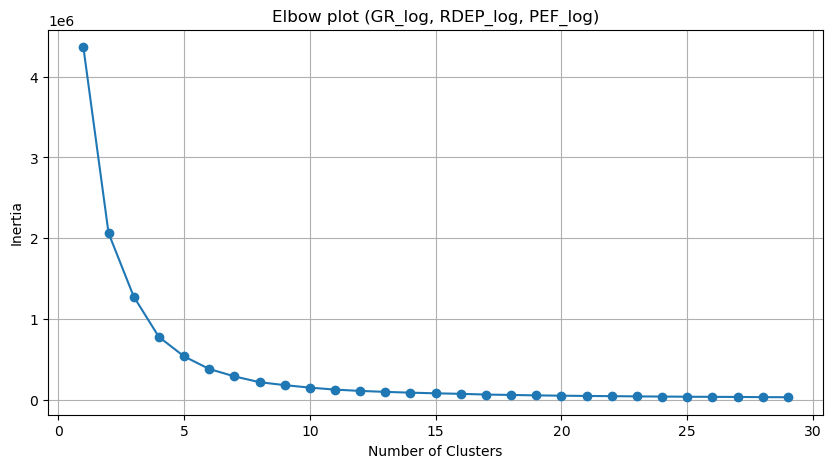

In [198]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log)')
plt.grid(True)
plt.show()

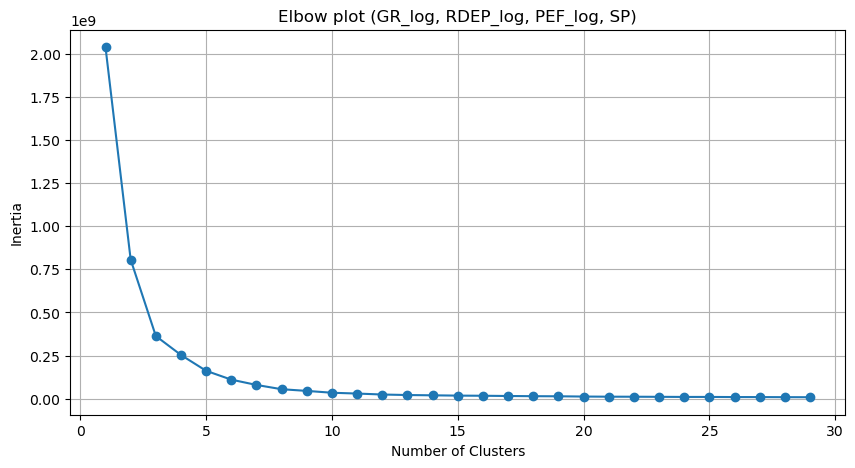

In [199]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'SP']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, SP)')
plt.grid(True)
plt.show()

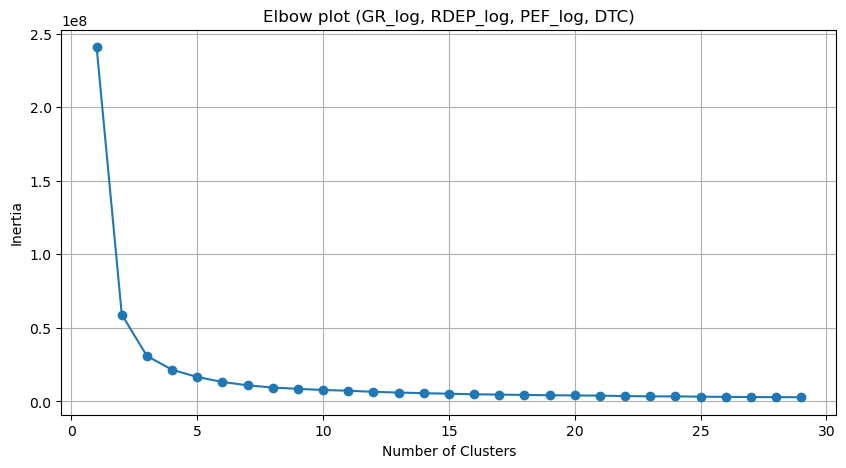

In [200]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'DTC']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, DTC)')
plt.grid(True)
plt.show()

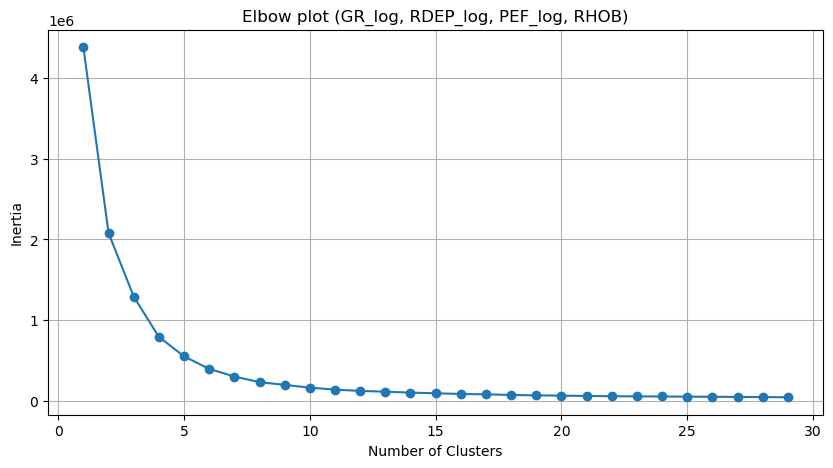

In [201]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'RHOB']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, RHOB)')
plt.grid(True)
plt.show()

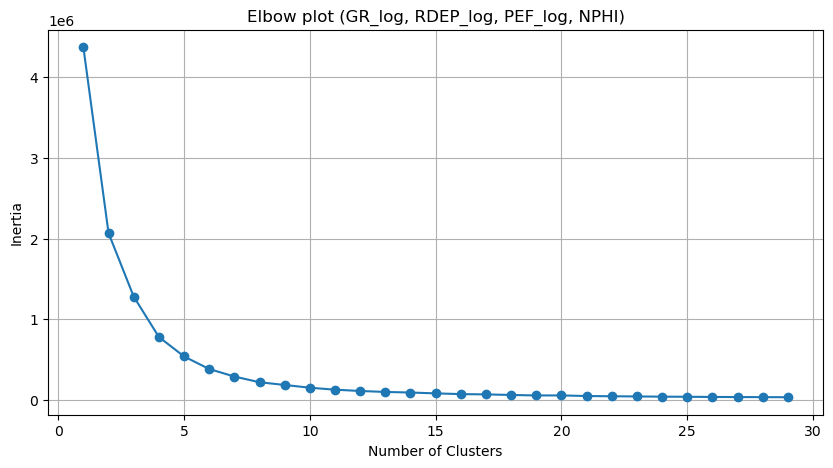

In [202]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI)')
plt.grid(True)
plt.show()

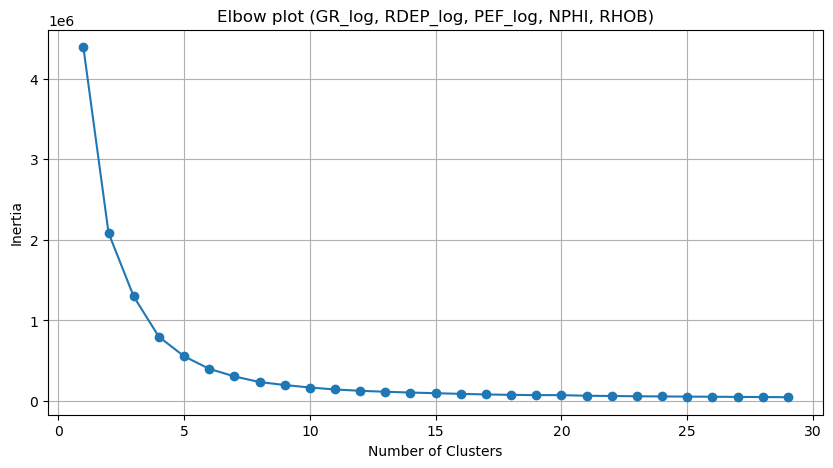

In [203]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'RHOB']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI, RHOB)')
plt.grid(True)
plt.show()

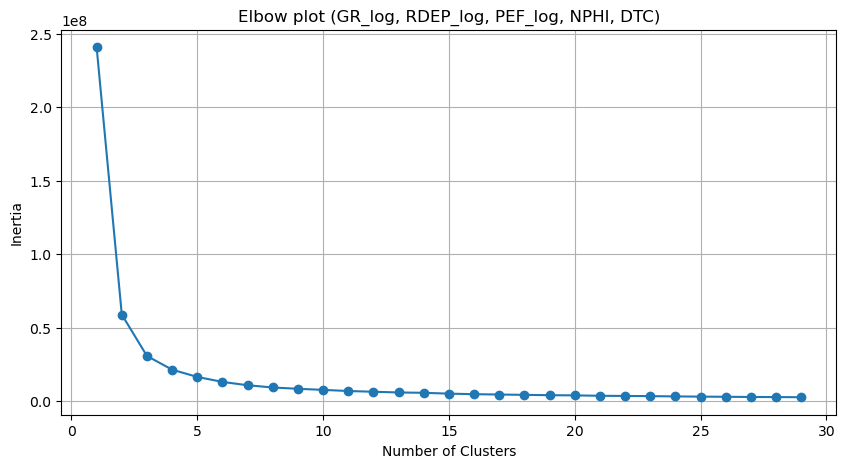

In [204]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'DTC']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI, DTC)')
plt.grid(True)
plt.show()

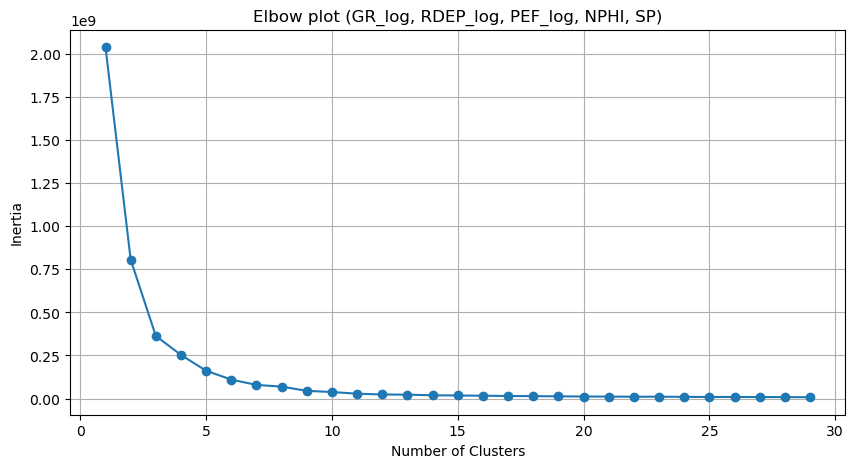

In [205]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'SP']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI, SP)')
plt.grid(True)
plt.show()

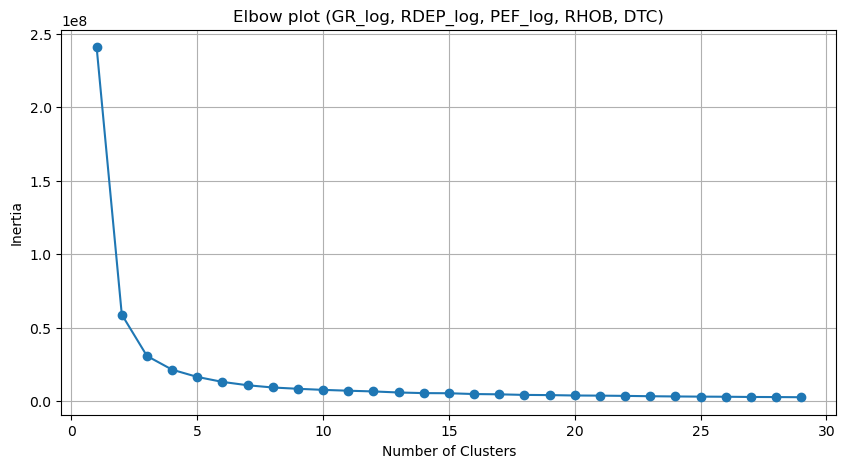

In [206]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'RHOB', 'DTC']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, RHOB, DTC)')
plt.grid(True)
plt.show()

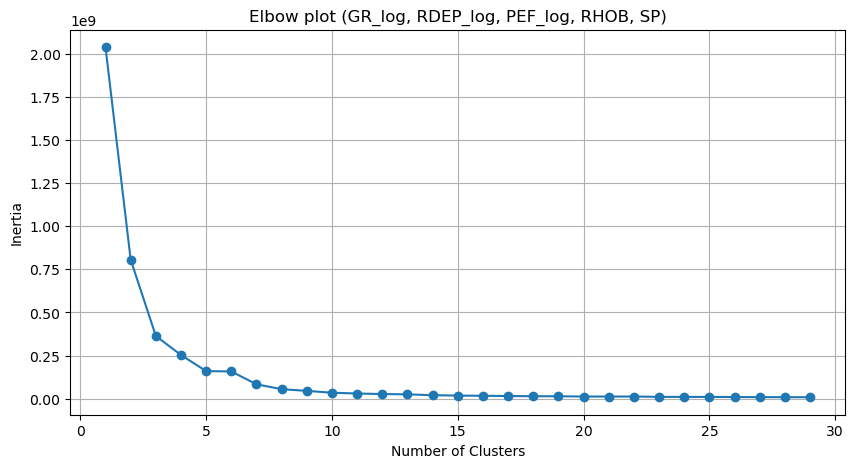

In [207]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'RHOB', 'SP']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, RHOB, SP)')
plt.grid(True)
plt.show()

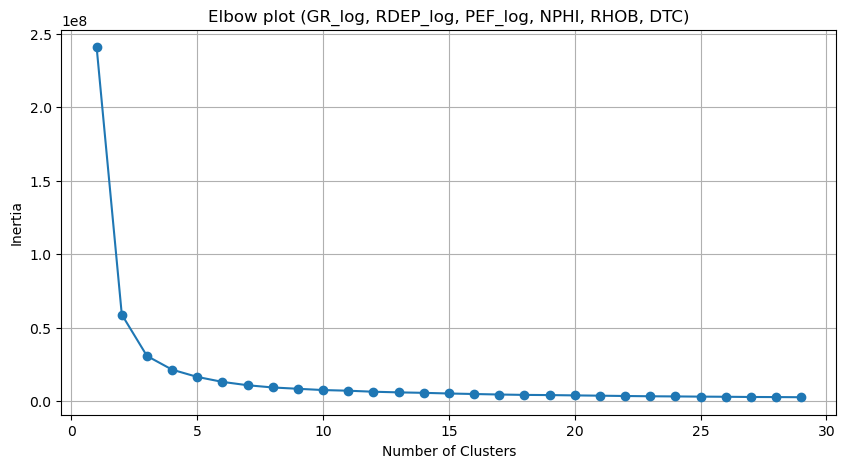

In [208]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'RHOB', 'DTC']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI, RHOB, DTC)')
plt.grid(True)
plt.show()

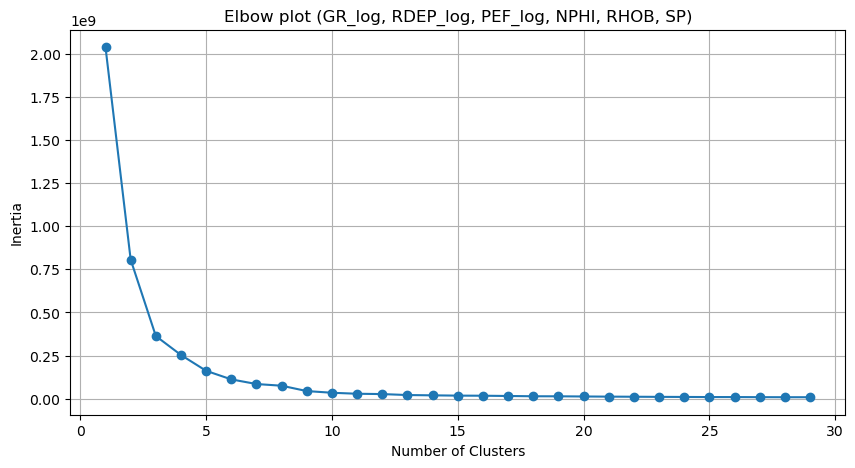

In [209]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'RHOB', 'SP']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI, RHOB, SP)')
plt.grid(True)
plt.show()

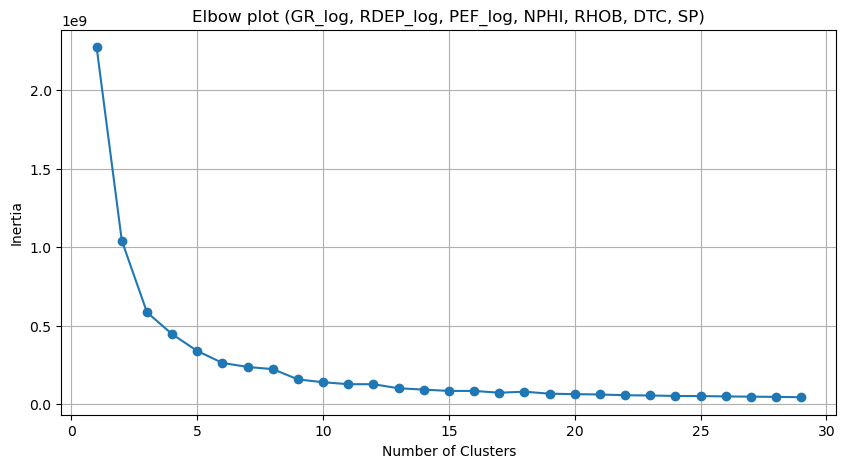

In [210]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'RHOB', 'DTC', 'SP']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI, RHOB, DTC, SP)')
plt.grid(True)
plt.show()

### Clustering

In [20]:
Kmeans = KMeans(n_clusters = 5)

In [21]:
Kmeans.fit(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'RHOB']])

KMeans(n_clusters=5)

In [22]:
well_clustered['KMeans'] = Kmeans.labels_
well_clustered

C:\Users\V330\AppData\Local\Temp\ipykernel_23784\870997332.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  well_clustered['KMeans'] = Kmeans.labels_


,WELL,DEPTH,GR_log,RDEP_log,PEF_log,NPHI,RHOB,SP,DTC,CALI,GR,RDEP,PEF,LITHOLOGY,GROUP,FORMATION,LIT,LITCOLOR,KMeans
11764,16/7-6,1111.390400,18.944290,0.569346,1.135126,0.618056,1.613800,-171.557785,135.565628,12.113527,106.853973,1.341479,26.490999,65000,ROGALAND GP.,Balder Fm.,Shale,#bebebe,3
11765,16/7-6,1111.542400,19.170494,0.565480,1.135126,0.618056,1.613800,-171.400635,134.172516,12.107354,109.183914,1.320168,26.490999,65000,ROGALAND GP.,Balder Fm.,Shale,#bebebe,3
11766,16/7-6,1111.694400,19.175644,0.560343,1.135126,0.618056,1.613800,-171.351654,132.024536,12.097067,109.237251,1.292451,26.490999,65000,ROGALAND GP.,Balder Fm.,Shale,#bebebe,3
11767,16/7-6,1111.846400,18.965291,0.557883,1.135126,0.618056,1.613800,-171.271606,131.170486,12.082504,107.069244,1.279413,26.490999,65000,ROGALAND GP.,Balder Fm.,Shale,#bebebe,3
11768,16/7-6,1111.998400,18.416267,0.560137,1.135126,0.618056,1.613800,-171.158920,129.776886,12.079053,101.511589,1.291357,26.490999,65000,ROGALAND GP.,Balder Fm.,Shale,#bebebe,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1285489,16/4-1,2676.241604,15.698187,0.797401,0.885245,0.091573,2.557105,97.844002,59.515186,15.984962,76.146736,4.146212,3.880900,30000,BASEMENT,BASEMENT,Sandstone,#ffff00,1
1285490,16/4-1,2676.393604,15.520806,0.813230,0.885245,0.095412,2.569884,97.636314,57.478436,15.777861,74.615852,4.617131,3.880900,30000,BASEMENT,BASEMENT,Sandstone,#ffff00,1
1285491,16/4-1,2676.545604,15.601981,0.827229,0.885245,0.101368,2.567297,99.243752,56.824402,15.678724,75.314545,5.112565,3.880900,30000,BASEMENT,BASEMENT,Sandstone,#ffff00,1
1285492,16/4-1,2676.697604,15.860108,0.820942,0.897725,0.108051,2.557530,100.004875,56.466286,15.738674,77.557510,4.879571,4.115452,30000,BASEMENT,BASEMENT,Sandstone,#ffff00,1


In [23]:
well_clustered['KMeans'].unique()

array([3, 1, 0, 2, 4])

In [24]:
well_clustered['KMeans'] = well_clustered['KMeans'].apply(lambda x: x+1)
well_clustered['KMeans'].unique()

C:\Users\V330\AppData\Local\Temp\ipykernel_23784\1861890788.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  well_clustered['KMeans'] = well_clustered['KMeans'].apply(lambda x: x+1)


array([4, 2, 1, 3, 5], dtype=int64)

In [33]:
kmeanscolor = {1: '#bebebe',
               2: '#ffff00',
               3: '#ff8c00',
               4: '#80ffff',
               5: '#008100'}

## Clustering result

### Groupby

In [55]:
grouped_kmeans = well_clustered.groupby('KMeans', sort=True)

keys_kmeans = [key for key, _ in grouped_clustered] #groupby based on unique keys or categories (1)
keys_kmeans #show groupby keys or categories
#grouped.groups.keys() #groupby based on unique keys or categories (1)
#grouped.apply(display) #show groupby data

[1, 2, 3, 4, 5]

In [56]:
grouped_lithology = well_clustered.groupby('LIT', sort=False)

keys_lithology = [key for key, _ in grouped_lithology] #groupby based on unique keys or categories (1)
keys_lithology #show groupby keys or categories
#grouped.groups.keys() #groupby based on unique keys or categories (1)
#grouped.apply(display) #show groupby data

C:\Users\V330\AppData\Local\Temp\ipykernel_23784\2648459692.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_lithology = well_clustered.groupby('LIT', sort=False)


['Shale',
 'Sandstone',
 'Limestone',
 'Dolomite',
 'Sandy Shale',
 'Volcaniclastics',
 'Marl',
 'Chalk',
 'Coal',
 'Halite',
 'Anhydrite',
 'Basement']

### Crossplot

#### NPHI-RHOB

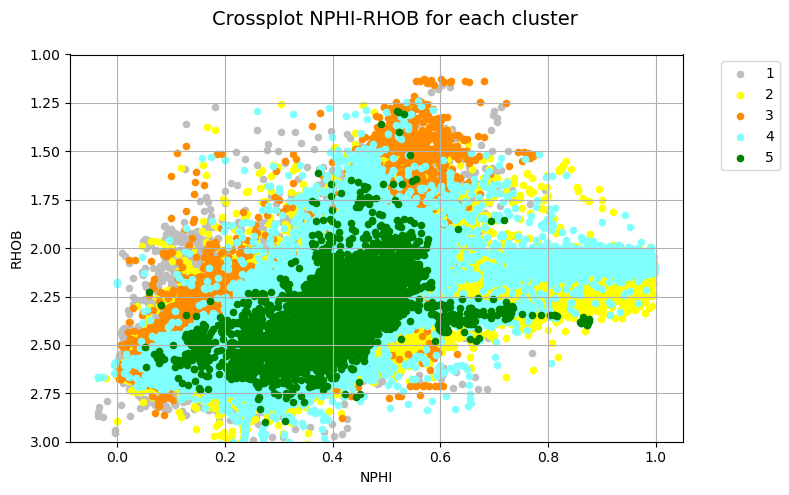

In [60]:
#Crossplot NPHI-RHOB

fig, ax = plt.subplots(figsize=(8,5))
fig.suptitle('Crossplot NPHI-RHOB for each cluster', fontsize=14)
for key, group in grouped_kmeans:
    group.plot(ax=ax, kind='scatter', x='NPHI', y='RHOB', label=key, color=kmeanscolor[key])
    
plt.ylim(3,1)
#plt.xlim(0,200)
plt.grid()
plt.ylabel('RHOB')
plt.xlabel('NPHI')

plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.subplots_adjust(top=0.95)
plt.tight_layout()
#plt.savefig('nphirhoball_lowertriassicdata_old.png')
plt.show()

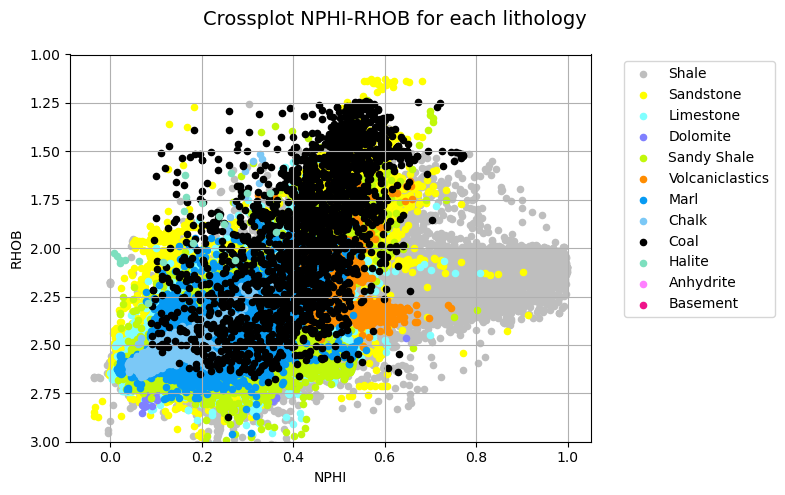

In [61]:
#Crossplot NPHI-RHOB

fig, ax = plt.subplots(figsize=(8,5))
fig.suptitle('Crossplot NPHI-RHOB for each lithology', fontsize=14)
for key, group in grouped_lithology:
    group.plot(ax=ax, kind='scatter', x='NPHI', y='RHOB', label=key, color=litocolor[key])
    
plt.ylim(3,1)
#plt.xlim(0,200)
plt.grid()
plt.ylabel('RHOB')
plt.xlabel('NPHI')

plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.subplots_adjust(top=0.95)
plt.tight_layout()
#plt.savefig('nphirhoball_lowertriassicdata_old.png')
plt.show()

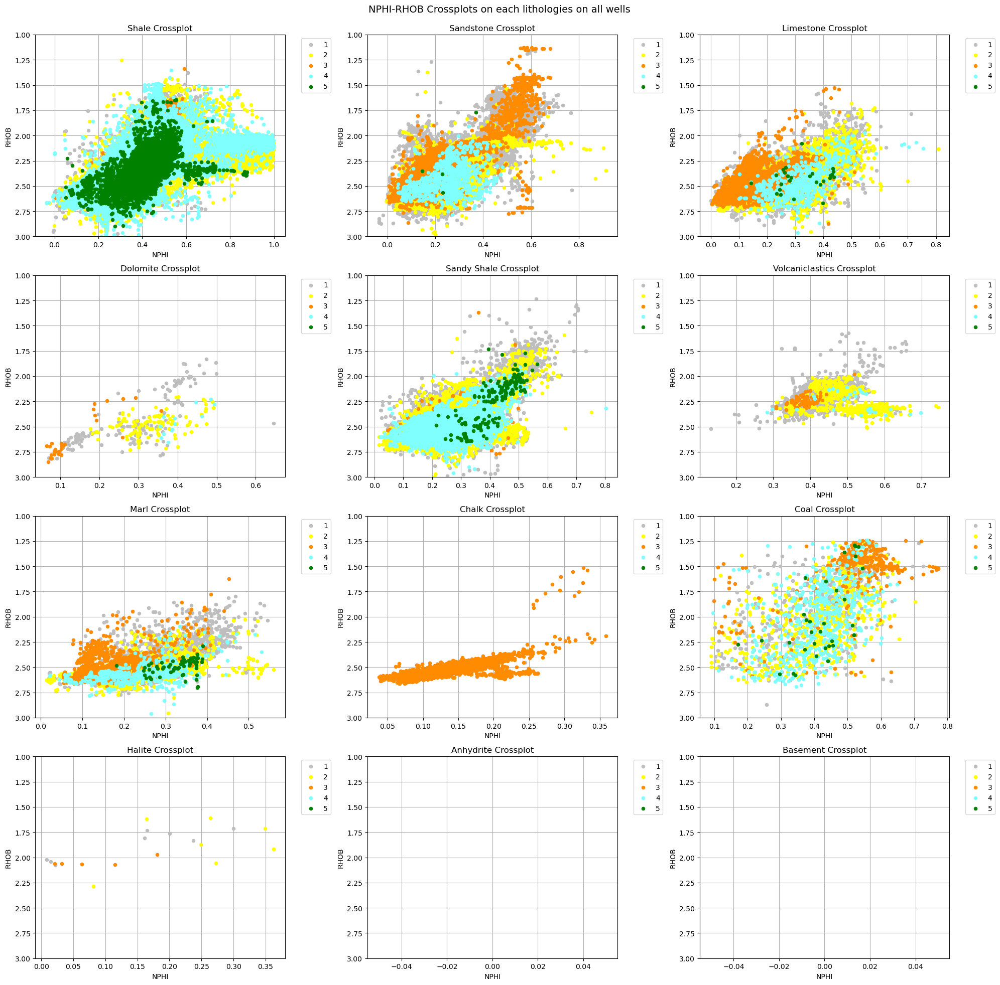

In [54]:
fig = plt.figure(figsize=(20,20))

for i, litho in enumerate(keys_lithology):
    ax=fig.add_subplot(4,3,i+1)
    ax.set_title(litho+" Crossplot")
    ax.set_axisbelow(True)
    fig.suptitle('NPHI-RHOB Crossplots on each lithologies on all wells', fontsize=14)
    
    for key, group in grouped_clustered:
        group[group['LIT'].isin([litho])].plot(ax=ax, kind='scatter', x='NPHI', y='RHOB', label=key, color=kmeanscolor[key])
    
    ax.set_ylim(3,1)
    #ax.set_xlim(40,240)
    ax.grid()
    ax.set_ylabel('RHOB')
    ax.set_xlabel('NPHI')

    ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
#plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.savefig('nphirhoblithology_triassicdata_new.png')
plt.show()

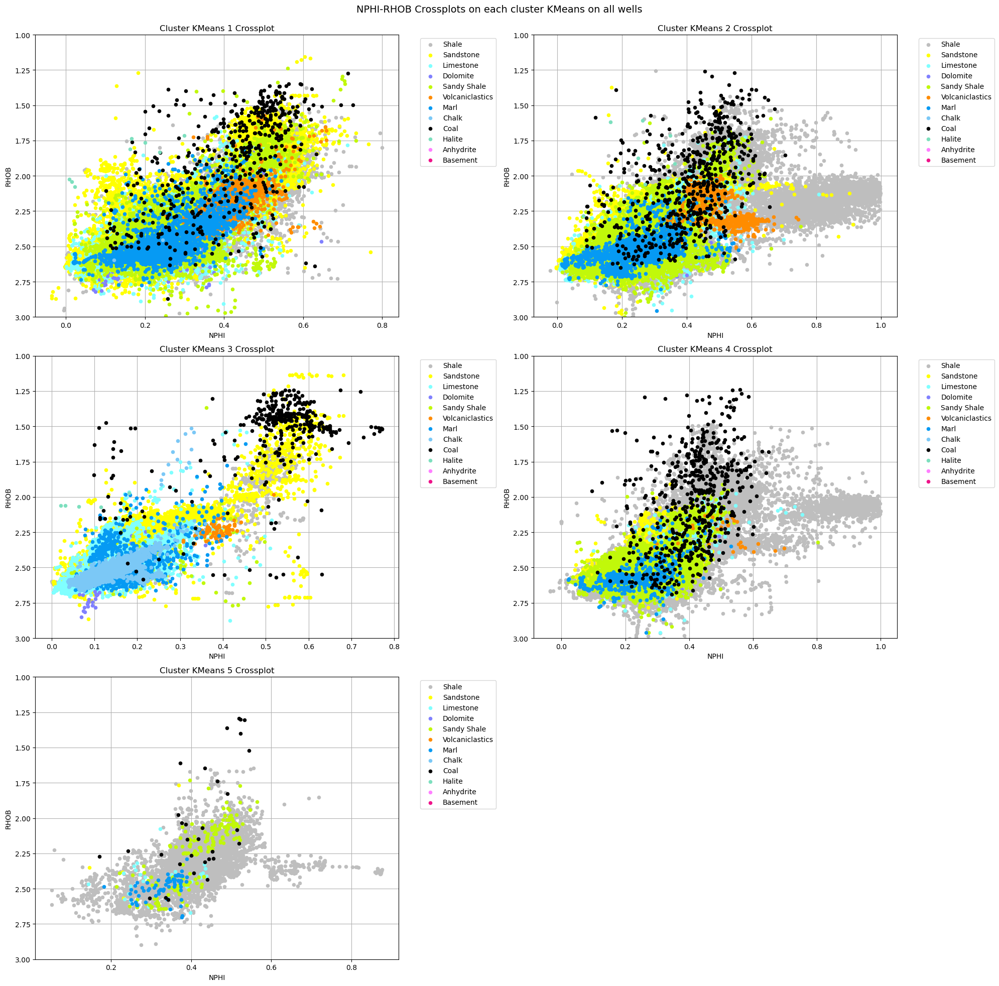

In [59]:
fig = plt.figure(figsize=(20,20))

for i, kmeans in enumerate(keys_kmeans):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title("Cluster KMeans "+str(kmeans)+" Crossplot")
    ax.set_axisbelow(True)
    fig.suptitle('NPHI-RHOB Crossplots on each cluster KMeans on all wells', fontsize=14)
    
    for key, group in grouped_lithology:
        group[group['KMeans'].isin([kmeans])].plot(ax=ax, kind='scatter', x='NPHI', y='RHOB', label=key, color=litocolor[key])
    
    ax.set_ylim(3,1)
    #ax.set_xlim(40,240)
    ax.grid()
    ax.set_ylabel('RHOB')
    ax.set_xlabel('NPHI')

    ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
#plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.savefig('nphirhoblithology_triassicdata_new.png')
plt.show()

#### GR-RHOB

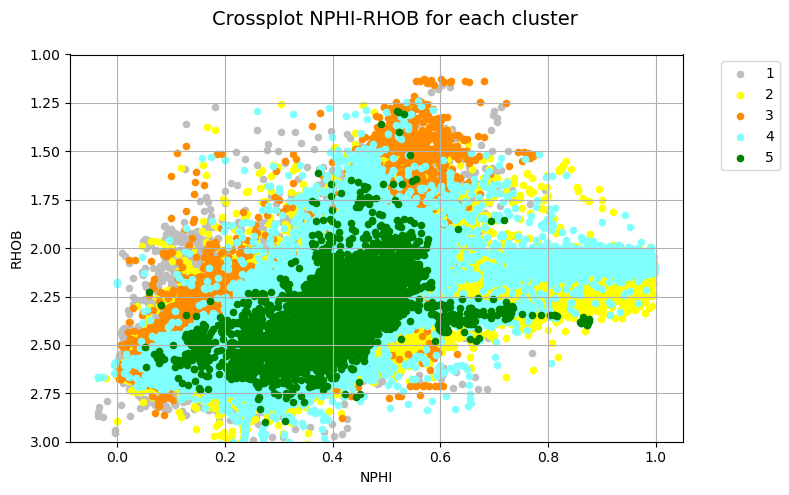

In [ ]:
#Crossplot NPHI-RHOB

fig, ax = plt.subplots(figsize=(8,5))
fig.suptitle('Crossplot NPHI-RHOB for each cluster', fontsize=14)
for key, group in grouped_kmeans:
    group.plot(ax=ax, kind='scatter', x='NPHI', y='RHOB', label=key, color=kmeanscolor[key])
    
plt.ylim(3,1)
#plt.xlim(0,200)
plt.grid()
plt.ylabel('RHOB')
plt.xlabel('NPHI')

plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.subplots_adjust(top=0.95)
plt.tight_layout()
#plt.savefig('nphirhoball_lowertriassicdata_old.png')
plt.show()

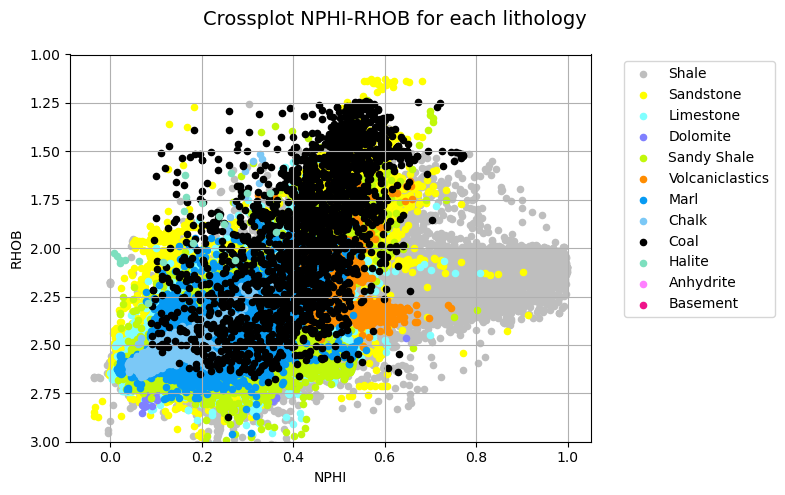

In [ ]:
#Crossplot NPHI-RHOB

fig, ax = plt.subplots(figsize=(8,5))
fig.suptitle('Crossplot NPHI-RHOB for each lithology', fontsize=14)
for key, group in grouped_lithology:
    group.plot(ax=ax, kind='scatter', x='NPHI', y='RHOB', label=key, color=litocolor[key])
    
plt.ylim(3,1)
#plt.xlim(0,200)
plt.grid()
plt.ylabel('RHOB')
plt.xlabel('NPHI')

plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.subplots_adjust(top=0.95)
plt.tight_layout()
#plt.savefig('nphirhoball_lowertriassicdata_old.png')
plt.show()

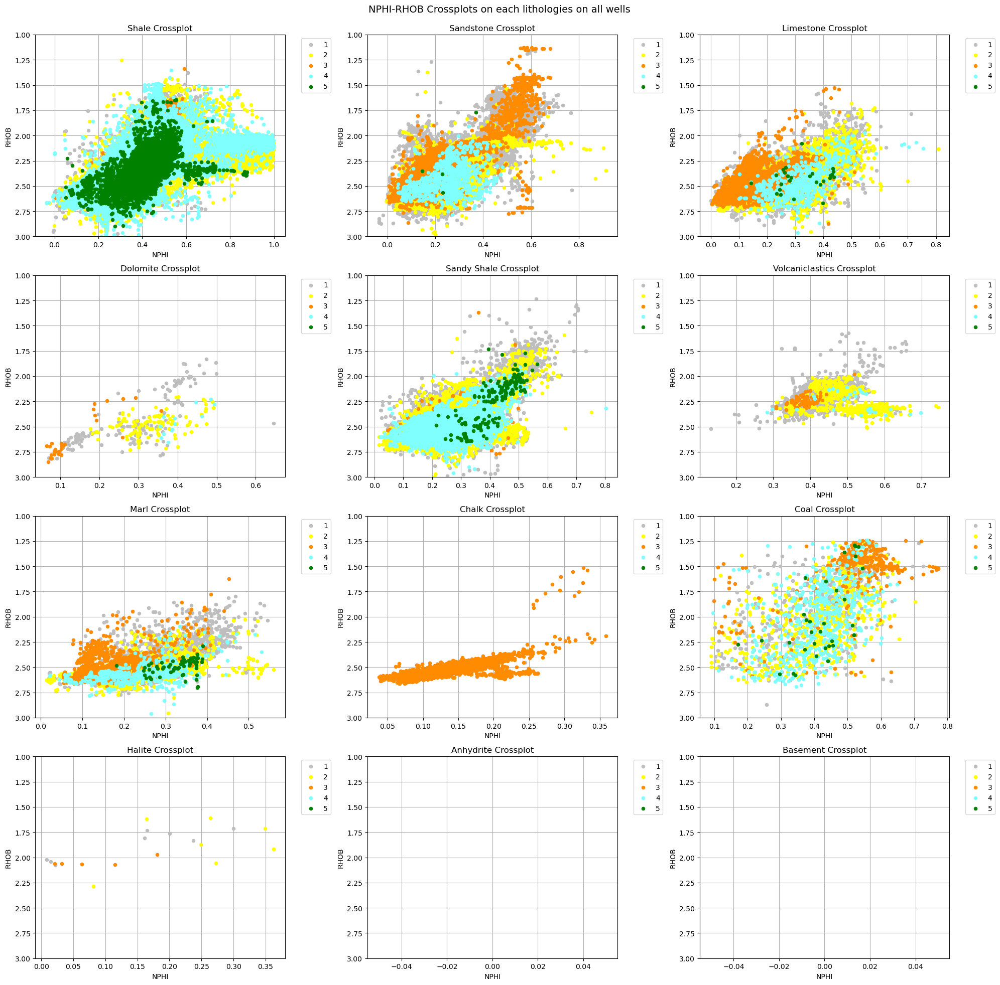

In [ ]:
fig = plt.figure(figsize=(20,20))

for i, litho in enumerate(keys_lithology):
    ax=fig.add_subplot(4,3,i+1)
    ax.set_title(litho+" Crossplot")
    ax.set_axisbelow(True)
    fig.suptitle('NPHI-RHOB Crossplots on each lithologies on all wells', fontsize=14)
    
    for key, group in grouped_clustered:
        group[group['LIT'].isin([litho])].plot(ax=ax, kind='scatter', x='NPHI', y='RHOB', label=key, color=kmeanscolor[key])
    
    ax.set_ylim(3,1)
    #ax.set_xlim(40,240)
    ax.grid()
    ax.set_ylabel('RHOB')
    ax.set_xlabel('NPHI')

    ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
#plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.savefig('nphirhoblithology_triassicdata_new.png')
plt.show()

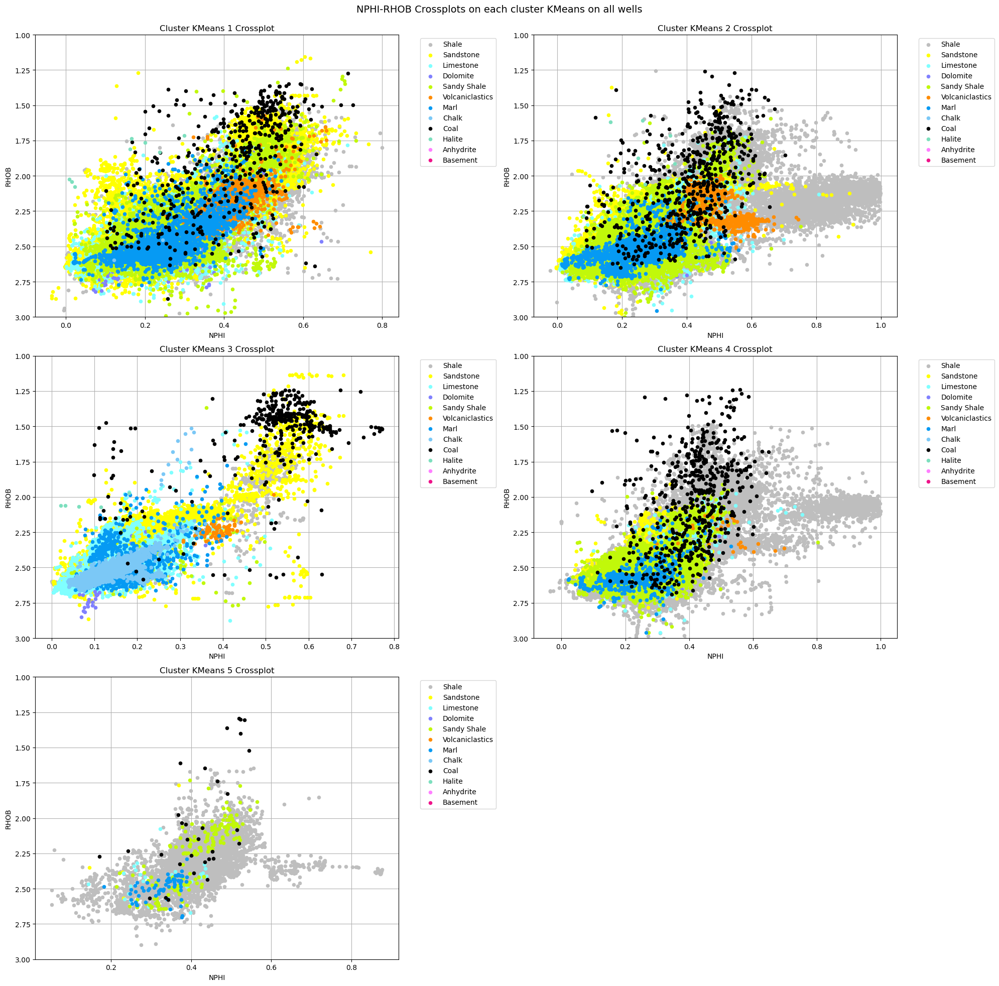

In [ ]:
fig = plt.figure(figsize=(20,20))

for i, kmeans in enumerate(keys_kmeans):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title("Cluster KMeans "+str(kmeans)+" Crossplot")
    ax.set_axisbelow(True)
    fig.suptitle('NPHI-RHOB Crossplots on each cluster KMeans on all wells', fontsize=14)
    
    for key, group in grouped_lithology:
        group[group['KMeans'].isin([kmeans])].plot(ax=ax, kind='scatter', x='NPHI', y='RHOB', label=key, color=litocolor[key])
    
    ax.set_ylim(3,1)
    #ax.set_xlim(40,240)
    ax.grid()
    ax.set_ylabel('RHOB')
    ax.set_xlabel('NPHI')

    ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
#plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.savefig('nphirhoblithology_triassicdata_new.png')
plt.show()

#### PEF-RHOB

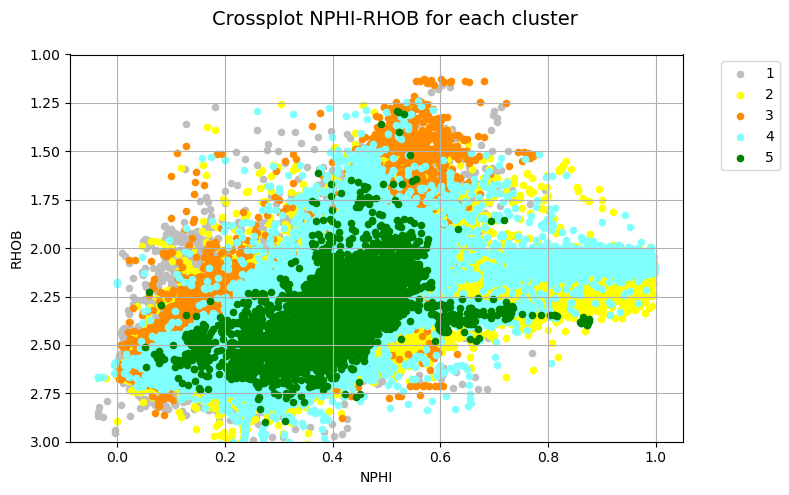

In [ ]:
#Crossplot NPHI-RHOB

fig, ax = plt.subplots(figsize=(8,5))
fig.suptitle('Crossplot NPHI-RHOB for each cluster', fontsize=14)
for key, group in grouped_kmeans:
    group.plot(ax=ax, kind='scatter', x='NPHI', y='RHOB', label=key, color=kmeanscolor[key])
    
plt.ylim(3,1)
#plt.xlim(0,200)
plt.grid()
plt.ylabel('RHOB')
plt.xlabel('NPHI')

plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.subplots_adjust(top=0.95)
plt.tight_layout()
#plt.savefig('nphirhoball_lowertriassicdata_old.png')
plt.show()

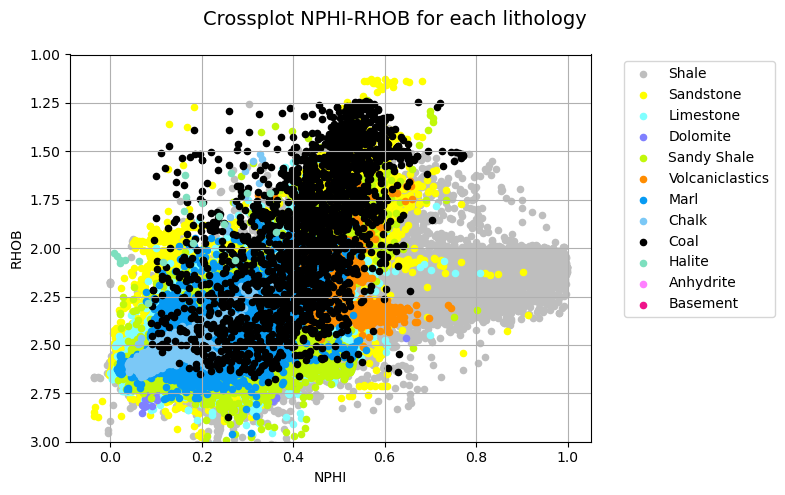

In [ ]:
#Crossplot NPHI-RHOB

fig, ax = plt.subplots(figsize=(8,5))
fig.suptitle('Crossplot NPHI-RHOB for each lithology', fontsize=14)
for key, group in grouped_lithology:
    group.plot(ax=ax, kind='scatter', x='NPHI', y='RHOB', label=key, color=litocolor[key])
    
plt.ylim(3,1)
#plt.xlim(0,200)
plt.grid()
plt.ylabel('RHOB')
plt.xlabel('NPHI')

plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.subplots_adjust(top=0.95)
plt.tight_layout()
#plt.savefig('nphirhoball_lowertriassicdata_old.png')
plt.show()

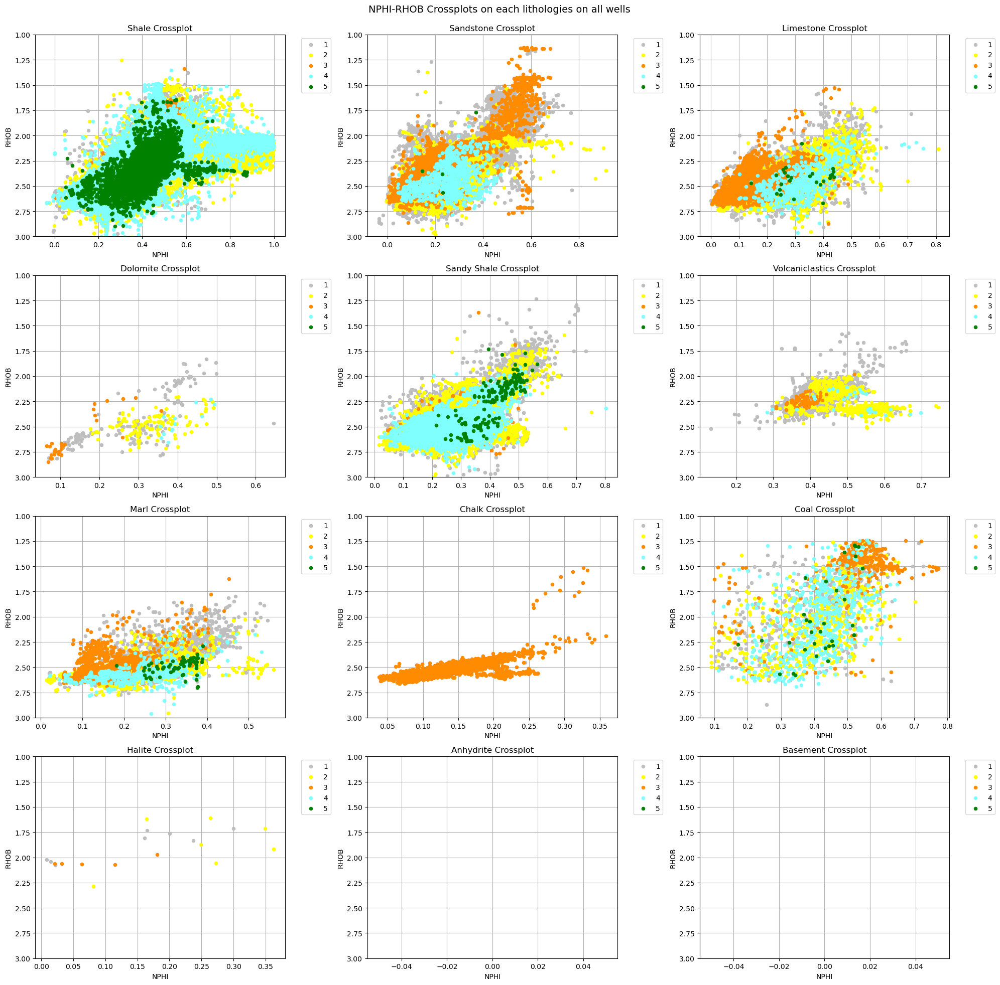

In [ ]:
fig = plt.figure(figsize=(20,20))

for i, litho in enumerate(keys_lithology):
    ax=fig.add_subplot(4,3,i+1)
    ax.set_title(litho+" Crossplot")
    ax.set_axisbelow(True)
    fig.suptitle('NPHI-RHOB Crossplots on each lithologies on all wells', fontsize=14)
    
    for key, group in grouped_clustered:
        group[group['LIT'].isin([litho])].plot(ax=ax, kind='scatter', x='NPHI', y='RHOB', label=key, color=kmeanscolor[key])
    
    ax.set_ylim(3,1)
    #ax.set_xlim(40,240)
    ax.grid()
    ax.set_ylabel('RHOB')
    ax.set_xlabel('NPHI')

    ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
#plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.savefig('nphirhoblithology_triassicdata_new.png')
plt.show()

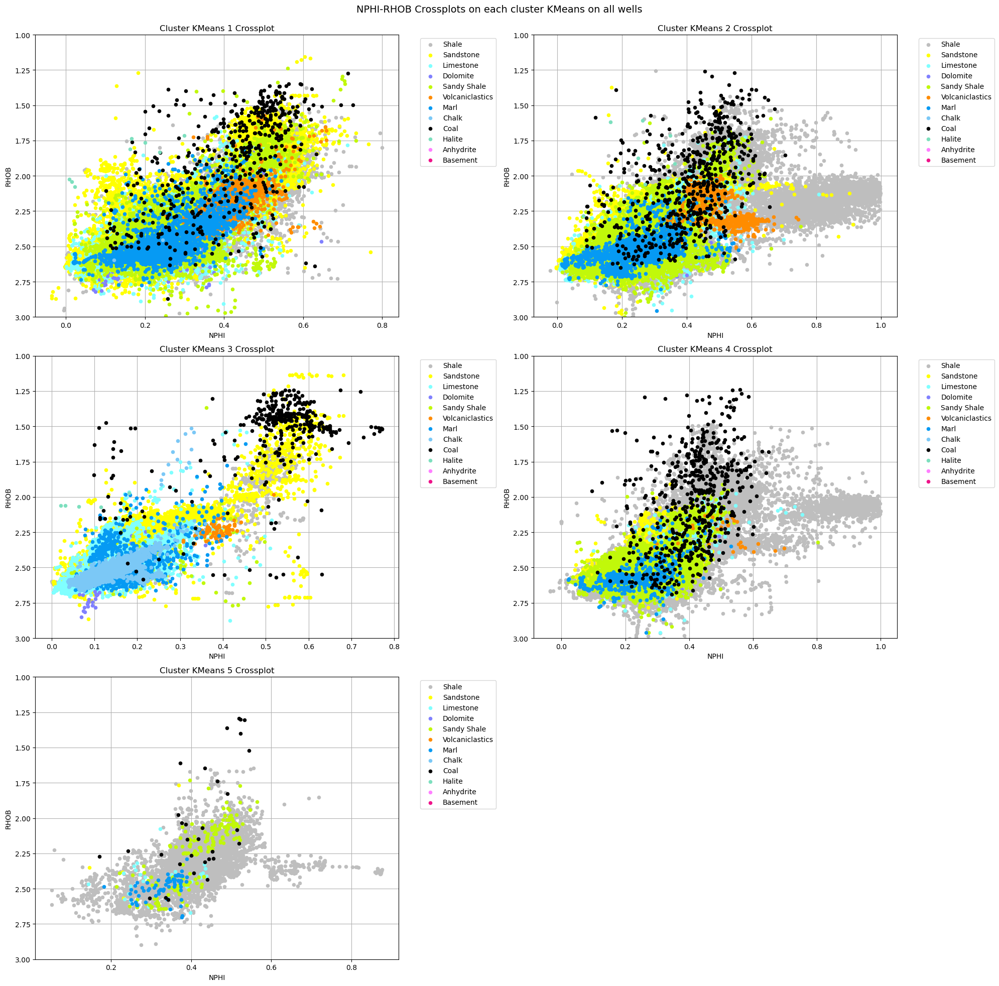

In [ ]:
fig = plt.figure(figsize=(20,20))

for i, kmeans in enumerate(keys_kmeans):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title("Cluster KMeans "+str(kmeans)+" Crossplot")
    ax.set_axisbelow(True)
    fig.suptitle('NPHI-RHOB Crossplots on each cluster KMeans on all wells', fontsize=14)
    
    for key, group in grouped_lithology:
        group[group['KMeans'].isin([kmeans])].plot(ax=ax, kind='scatter', x='NPHI', y='RHOB', label=key, color=litocolor[key])
    
    ax.set_ylim(3,1)
    #ax.set_xlim(40,240)
    ax.grid()
    ax.set_ylabel('RHOB')
    ax.set_xlabel('NPHI')

    ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
#plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.savefig('nphirhoblithology_triassicdata_new.png')
plt.show()

#### DTC-RHOB

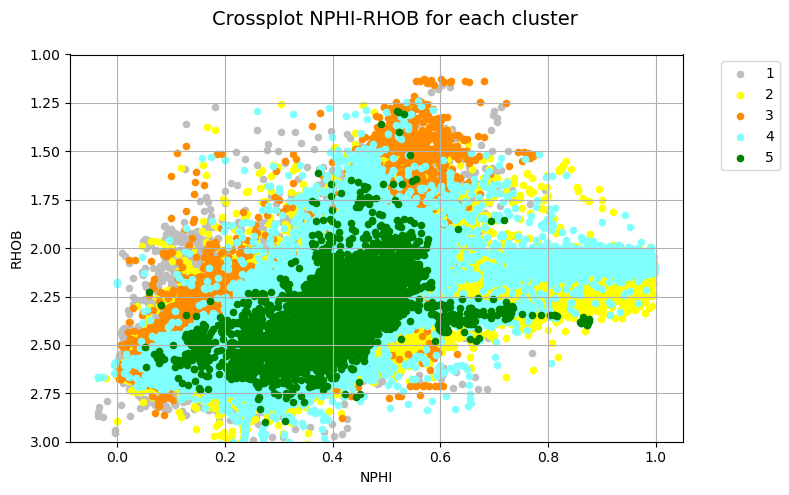

In [ ]:
#Crossplot NPHI-RHOB

fig, ax = plt.subplots(figsize=(8,5))
fig.suptitle('Crossplot NPHI-RHOB for each cluster', fontsize=14)
for key, group in grouped_kmeans:
    group.plot(ax=ax, kind='scatter', x='NPHI', y='RHOB', label=key, color=kmeanscolor[key])
    
plt.ylim(3,1)
#plt.xlim(0,200)
plt.grid()
plt.ylabel('RHOB')
plt.xlabel('NPHI')

plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.subplots_adjust(top=0.95)
plt.tight_layout()
#plt.savefig('nphirhoball_lowertriassicdata_old.png')
plt.show()

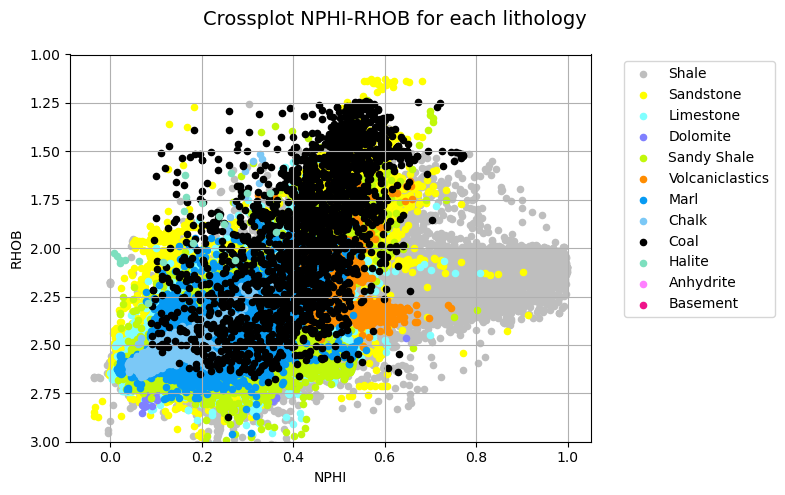

In [ ]:
#Crossplot NPHI-RHOB

fig, ax = plt.subplots(figsize=(8,5))
fig.suptitle('Crossplot NPHI-RHOB for each lithology', fontsize=14)
for key, group in grouped_lithology:
    group.plot(ax=ax, kind='scatter', x='NPHI', y='RHOB', label=key, color=litocolor[key])
    
plt.ylim(3,1)
#plt.xlim(0,200)
plt.grid()
plt.ylabel('RHOB')
plt.xlabel('NPHI')

plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.subplots_adjust(top=0.95)
plt.tight_layout()
#plt.savefig('nphirhoball_lowertriassicdata_old.png')
plt.show()

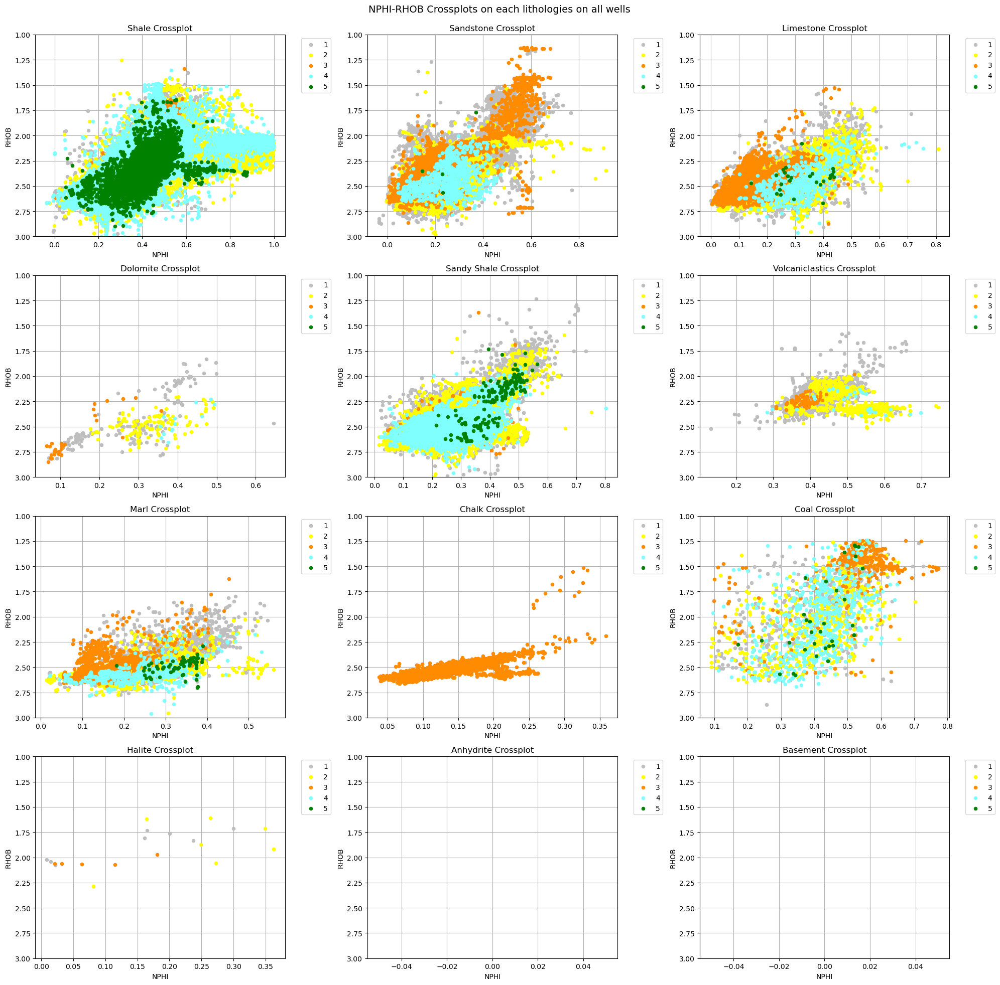

In [ ]:
fig = plt.figure(figsize=(20,20))

for i, litho in enumerate(keys_lithology):
    ax=fig.add_subplot(4,3,i+1)
    ax.set_title(litho+" Crossplot")
    ax.set_axisbelow(True)
    fig.suptitle('NPHI-RHOB Crossplots on each lithologies on all wells', fontsize=14)
    
    for key, group in grouped_clustered:
        group[group['LIT'].isin([litho])].plot(ax=ax, kind='scatter', x='NPHI', y='RHOB', label=key, color=kmeanscolor[key])
    
    ax.set_ylim(3,1)
    #ax.set_xlim(40,240)
    ax.grid()
    ax.set_ylabel('RHOB')
    ax.set_xlabel('NPHI')

    ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
#plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.savefig('nphirhoblithology_triassicdata_new.png')
plt.show()

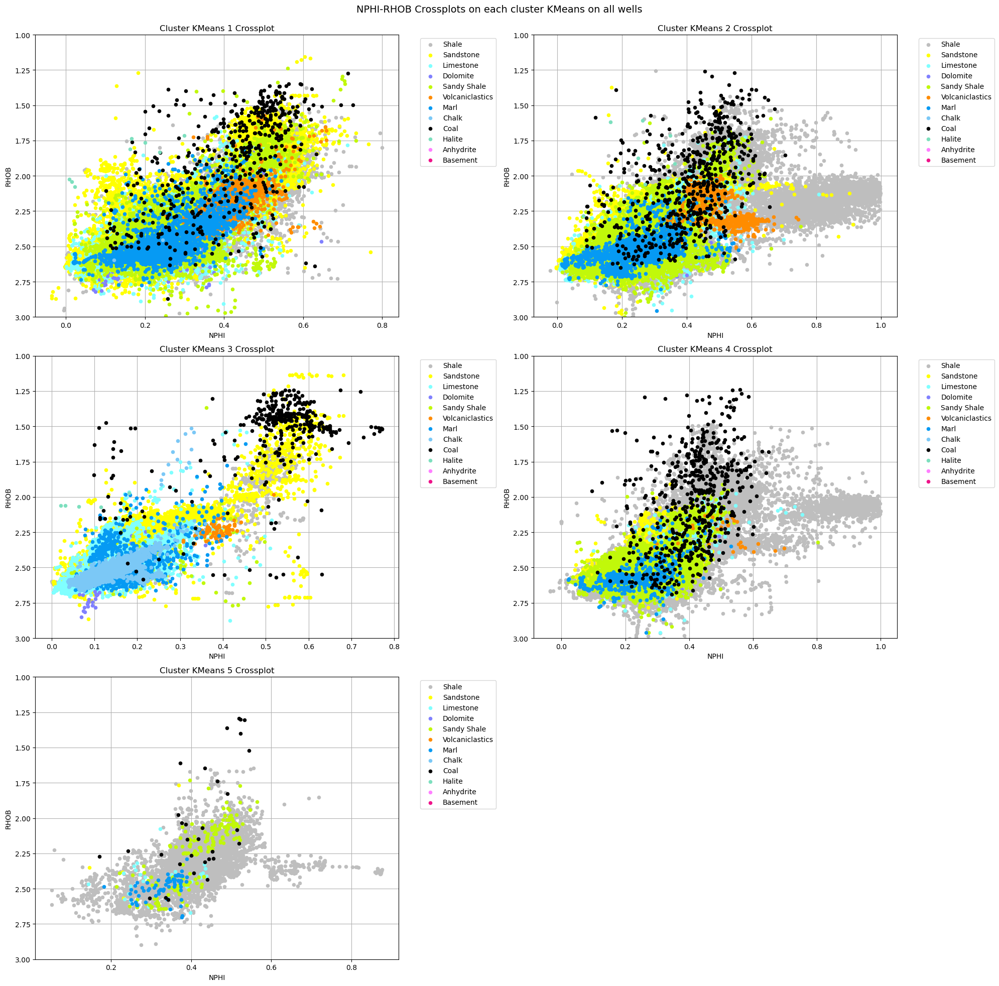

In [ ]:
fig = plt.figure(figsize=(20,20))

for i, kmeans in enumerate(keys_kmeans):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title("Cluster KMeans "+str(kmeans)+" Crossplot")
    ax.set_axisbelow(True)
    fig.suptitle('NPHI-RHOB Crossplots on each cluster KMeans on all wells', fontsize=14)
    
    for key, group in grouped_lithology:
        group[group['KMeans'].isin([kmeans])].plot(ax=ax, kind='scatter', x='NPHI', y='RHOB', label=key, color=litocolor[key])
    
    ax.set_ylim(3,1)
    #ax.set_xlim(40,240)
    ax.grid()
    ax.set_ylabel('RHOB')
    ax.set_xlabel('NPHI')

    ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
#plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.savefig('nphirhoblithology_triassicdata_new.png')
plt.show()

### Histograms

In [50]:
#Histogram on each specific column for more detail
well_curves = list(well) #Create a list of curve names
well_curves.remove("WELL") #Remove the depth curve to focus only on curves
well_curves.remove("DEPTH") #Remove the depth curve to focus only on curves
well_curves.remove("CALI") #Remove the depth curve to focus only on curves
well_curves.remove("BS") #Remove the depth curve to focus only on curves
well_curves.remove("LITHOLOGY") #Remove the depth curve to focus only on curves
well_curves.remove("GROUP") #Remove the depth curve to focus only on curves
well_curves.remove("FORMATION") #Remove the depth curve to focus only on curves
well_curves.remove("LIT") #Remove the depth curve to focus only on curves
well_curves.remove("LITCOLOR") #Remove the depth curve to focus only on curves
well_curves.remove("DRHO") #Remove the depth curve to focus only on curves

well_curves

['RSHA',
 'RMED',
 'RDEP',
 'RXO',
 'RMIC',
 'GR',
 'SGR',
 'NPHI',
 'PEF',
 'RHOB',
 'SP',
 'DTC',
 'DTS',
 'GR_log2',
 'GR_log10',
 'GR_logn',
 'GR_lognpandas',
 'GR_SS',
 'GR_PT',
 'GR_MMS']

#### Histogram for each well logs

In [ ]:
fig = plt.figure(figsize=(28,20))

for i, feature in enumerate(well_curves):
    ax=fig.add_subplot(4,4,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
    fig.suptitle('')
    
    if i<5:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well, x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('ohmm')
    elif 4<i<7:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well, x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('API')
    elif i==8:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well, x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('b/e')
    elif i==7:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well, x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('frac')
    elif i==9:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well, x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('gr/cc')
    elif i==10:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well, x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('mV')
    else:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well, x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('us/ft')

    sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
    ax.grid()
#plt.subplots_adjust(top=0.95)
plt.subplots_adjust(hspace=0.15, wspace=0.5)

plt.tight_layout()
plt.savefig('histogramlithology_stackcount_triassicdata_new.png')
plt.show()

In [ ]:
fig = plt.figure(figsize=(28,20))

for i, feature in enumerate(well_curves):
    ax=fig.add_subplot(4,4,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
    fig.suptitle('')
    
    if i<5:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well, x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('ohmm')
    elif 4<i<7:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well, x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('API')
    elif i==8:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well, x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('b/e')
    elif i==7:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well, x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('frac')
    elif i==9:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well, x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('gr/cc')
    elif i==10:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well, x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('mV')
    else:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well, x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('us/ft')

    sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
    ax.grid()
#plt.subplots_adjust(top=0.95)
plt.subplots_adjust(hspace=0.15, wspace=0.5)

plt.tight_layout()
plt.savefig('histogramlithology_stackproportion_triassicdata_new.png')
plt.show()

In [ ]:
fig = plt.figure(figsize=(28,20))

for i, feature in enumerate(well_curves):
    ax=fig.add_subplot(4,4,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
    fig.suptitle('')
    
    if i<5:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well, x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('ohmm')
    elif 4<i<7:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well, x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('API')
    elif i==8:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well, x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('b/e')
    elif i==7:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well, x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('frac')
    elif i==9:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well, x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('gr/cc')
    elif i==10:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well, x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('mV')
    else:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well, x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('us/ft')

    sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
    ax.grid()
#plt.subplots_adjust(top=0.95)
plt.subplots_adjust(hspace=0.15, wspace=0.5)

plt.tight_layout()
plt.savefig('histogramlithology_layercount_triassicdata_new.png')
plt.show()

In [ ]:
fig = plt.figure(figsize=(28,20))

for i, feature in enumerate(well_curves):
    ax=fig.add_subplot(4,4,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
    fig.suptitle('')
    
    if i<5:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well, x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('ohmm')
    elif 4<i<7:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well, x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('API')
    elif i==8:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well, x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('b/e')
    elif i==7:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well, x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('frac')
    elif i==9:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well, x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('gr/cc')
    elif i==10:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well, x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('mV')
    else:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well, x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('us/ft')

    sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
    ax.grid()
#plt.subplots_adjust(top=0.95)
plt.subplots_adjust(hspace=0.15, wspace=0.5)

plt.tight_layout()
plt.savefig('histogramlithology_layerproportion_triassicdata_new.png')
plt.show()

### KDEs

In [ ]:
fig = plt.figure(figsize=(28,20))

for i, feature in enumerate(well_curves):
    ax=fig.add_subplot(4,4,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
    fig.suptitle('')
    
    if i<5:
        #well.groupby('WELL')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=False ,grid=True)
        ax=sns.kdeplot(data=well, x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=True, palette=litocolor, common_norm=False, common_grid=True)
        ax.set_xscale("log")
        ax.set_xlabel('ohmm')
        
    elif 4<i<7:
        #well.groupby('WELL')[feature].hist(bins=np.logspace(np.log10(1),np.log10(1000),40), ax=ax, legend=False ,grid=True)
        ax=sns.kdeplot(data=well, x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=True, palette=litocolor, common_norm=False, common_grid=True)
        ax.set_xscale("log")
        ax.set_xlabel('API')
    elif i==8:
        #well.groupby('WELL')[feature].hist(bins=np.logspace(np.log10(1),np.log10(1000),40), ax=ax, legend=False ,grid=True)
        ax=sns.kdeplot(data=well, x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=True, palette=litocolor, common_norm=False, common_grid=True)
        ax.set_xscale("log")
        ax.set_xlabel('b/e')
    elif i==7:
        #well.groupby('WELL')[feature].hist(bins=40, ax=ax, legend=False ,grid=True)
        ax=sns.kdeplot(data=well, x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=False, palette=litocolor, common_norm=False, common_grid=True)
        ax.set_xscale("linear")
        ax.set_xlabel('frac')
    elif i==9:
        #well.groupby('WELL')[feature].hist(bins=40, ax=ax, legend=False ,grid=True)
        ax=sns.kdeplot(data=well, x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=False, palette=litocolor, common_norm=False, common_grid=True)
        ax.set_xscale("linear")
        ax.set_xlabel('gr/cc')
    elif i==10:
        #well.groupby('WELL')[feature].hist(bins=40, ax=ax, legend=False ,grid=True)
        ax=sns.kdeplot(data=well, x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=False, palette=litocolor, common_norm=False, common_grid=True)
        ax.set_xscale("linear")
        ax.set_xlabel('mV')
    else:
        #well.groupby('WELL')[feature].hist(bins=40, ax=ax, legend=False ,grid=True)
        ax=sns.kdeplot(data=well, x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=False, palette=litocolor, common_norm=False, common_grid=True)
        ax.set_xscale("linear")
        ax.set_xlabel('us/ft')

    sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
    ax.grid()
#plt.subplots_adjust(top=0.95)
plt.subplots_adjust(hspace=0.15, wspace=0.5)

plt.tight_layout()
plt.savefig('kdelithology_triassicdata_new.png')
plt.show()

## Logplot

The well log display will be created in triple-combo style in matplotlib to visualize the curves. The template will be incorporated into **triple_combo_plot** function, so it can be used depending on the selection of top and bottom depths of the graph.

The triple combo display will consists of:

- First track: Gamma Ray - Spectral Gamma Ray, Caliper, Bit size, SP
- Second track: Resistivities
- Third track: Density, Neutron, PEF
- Fourth track: Sonic (Compressional and Shear)
- Fifth track: Lithology log labels
- Sixth track: Clustering results

### Lithology labels

In [214]:
well_clustered['LITHOLOGY'].unique()

array([65000, 30000, 70000, 74000, 65030, 99000, 80000, 70032, 90000,
       88000], dtype=int64)

In [215]:
lithology_numbers = {30000: {'lith':'Sandstone', 'lith_num':1, 'hatch': '', 'color':'#ffff00'},
                 65030: {'lith':'Sandy Shale', 'lith_num':2, 'hatch':'', 'color':'#c1f80a'},
                 65000: {'lith':'Shale', 'lith_num':3, 'hatch':'', 'color':'#bebebe'},
                 80000: {'lith':'Marl', 'lith_num':4, 'hatch':'', 'color':'#069af3'},
                 74000: {'lith':'Dolomite', 'lith_num':5, 'hatch':'', 'color':'#8080ff'},
                 70000: {'lith':'Limestone', 'lith_num':6, 'hatch':'', 'color':'#80ffff'},
                 70032: {'lith':'Chalk', 'lith_num':7, 'hatch':'', 'color':'#7bc8f6'},
                 88000: {'lith':'Halite', 'lith_num':8, 'hatch':'', 'color':'#7ddfbe'},
                 86000: {'lith':'Anhydrite', 'lith_num':9, 'hatch':'', 'color':'#ff80ff'},
                 99000: {'lith':'Volcaniclastics', 'lith_num':10, 'hatch':'', 'color':'#ff8c00'},
                 90000: {'lith':'Coal', 'lith_num':11, 'hatch':'', 'color':'black'},
                 93000: {'lith':'Basement', 'lith_num':12, 'hatch':'', 'color':'#ef138a'}}

df_lith = pd.DataFrame.from_dict(lithology_numbers, orient='index')
df_lith.index.name = 'LITHOLOGY'
df_lith

,lith,lith_num,hatch,color
LITHOLOGY,,,,
30000,Sandstone,1,,#ffff00
65030,Sandy Shale,2,,#c1f80a
65000,Shale,3,,#bebebe
80000,Marl,4,,#069af3
74000,Dolomite,5,,#8080ff
70000,Limestone,6,,#80ffff
70032,Chalk,7,,#7bc8f6
88000,Halite,8,,#7ddfbe
86000,Anhydrite,9,,#ff80ff


In [216]:
lith_code = dict(zip(df_lith.lith, df_lith.lith_num))
lith_colors = list(df_lith.color)
lith_cmap = ListedColormap(lith_colors)
lith_hatches = df_lith.hatch.to_list()

In [217]:
print(lith_code)
print(lith_colors)
#print(lith_cmap)
print(lith_hatches)

{'Sandstone': 1, 'Sandy Shale': 2, 'Shale': 3, 'Marl': 4, 'Dolomite': 5, 'Limestone': 6, 'Chalk': 7, 'Halite': 8, 'Anhydrite': 9, 'Volcaniclastics': 10, 'Coal': 11, 'Basement': 12}
['#ffff00', '#c1f80a', '#bebebe', '#069af3', '#8080ff', '#80ffff', '#7bc8f6', '#7ddfbe', '#ff80ff', '#ff8c00', 'black', '#ef138a']
['', '', '', '', '', '', '', '', '', '', '', '']


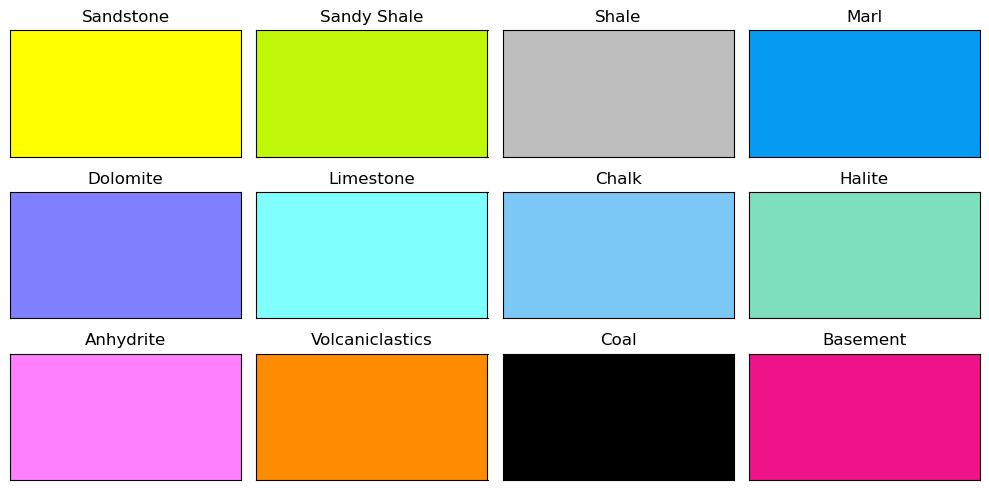

In [218]:
y = [0, 1]
x = [1, 1]

fig, axes = plt.subplots(ncols=4,nrows=3, sharex=True, sharey=True,
                         figsize=(10,5), subplot_kw={'xticks': [], 'yticks': []})

for ax, key in zip(axes.flat, lithology_numbers.keys()):
    ax.plot(x, y)
    ax.fill_betweenx(y, 0, 1, facecolor=lithology_numbers[key]['color'], hatch=lithology_numbers[key]['hatch'])
    ax.set_xlim(0, 0.1)
    ax.set_ylim(0, 1)
    ax.set_title(str(lithology_numbers[key]['lith']))

plt.tight_layout()

plt.show()

### Cluster labels

In [219]:
well_clustered['KMeans'].unique()

array([0, 4, 1, 2, 3])

In [321]:
kmeans_numbers = {1: {'kmeans_num':1, 'hatch': '', 'color':'#bebebe'},
                 2: {'kmeans_num':2, 'hatch':'', 'color':'#ffff00'},
                 3: {'kmeans_num':3, 'hatch':'', 'color':'#ff8c00'},
                 4: {'kmeans_num':4, 'hatch':'', 'color':'#80ffff'},
                 5: {'kmeans_num':5, 'hatch':'', 'color':'#008100'}}

df_kmeans = pd.DataFrame.from_dict(kmeans_numbers, orient='index')
df_kmeans.index.name = 'KMeans'
df_kmeans

,kmeans_num,hatch,color
KMeans,,,
1,1,,#bebebe
2,2,,#ffff00
3,3,,#ff8c00
4,4,,#80ffff
5,5,,#008100


In [322]:
kmeans_code = dict(zip(df_kmeans.index, df_kmeans.kmeans_num))
kmeans_colors = list(df_kmeans.color)
kmeans_cmap = ListedColormap(kmeans_colors)
kmeans_hatches = df_kmeans.hatch.to_list()

In [323]:
print(kmeans_code)
print(kmeans_colors)
#print(kmeans_cmap)
print(kmeans_hatches)

{1: 1, 2: 2, 3: 3, 4: 4, 5: 5}
['#bebebe', '#ffff00', '#ff8c00', '#80ffff', '#008100']
['', '', '', '', '']


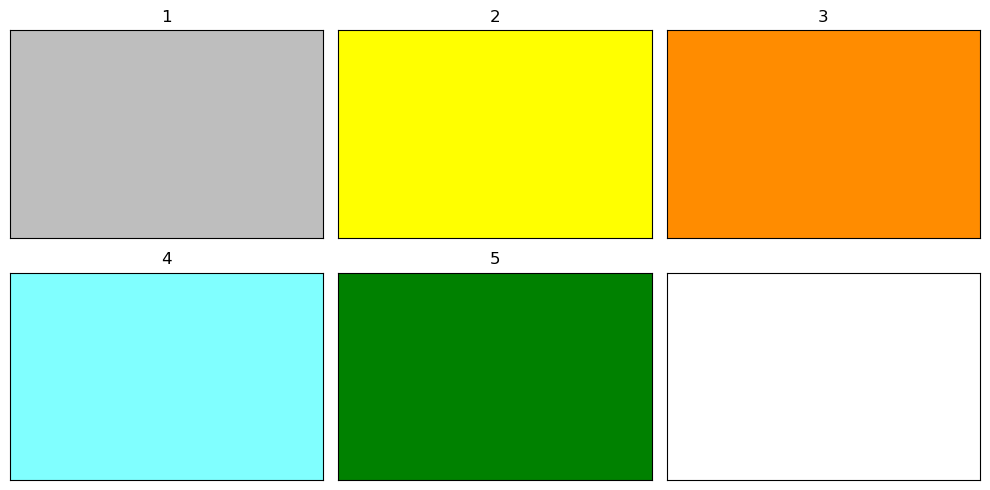

In [324]:
y = [0, 1]
x = [1, 1]

fig, axes = plt.subplots(ncols=3,nrows=2, sharex=True, sharey=True,
                         figsize=(10,5), subplot_kw={'xticks': [], 'yticks': []})

for ax, key in zip(axes.flat, kmeans_numbers.keys()):
    ax.plot(x, y)
    ax.fill_betweenx(y, 0, 1, facecolor=kmeans_numbers[key]['color'], hatch=kmeans_numbers[key]['hatch'])
    ax.set_xlim(0, 0.1)
    ax.set_ylim(0, 1)
    ax.set_title(str(kmeans_numbers[key]['kmeans_num']))

plt.tight_layout()

plt.show()

### Plotting

In [325]:
def triple_combo_plot(well_name, top_depth, bottom_depth):
    #Set well data
    well_data = well_clustered[well_clustered['WELL'] == well_name]
    logs=well_data[(well_data.DEPTH >= top_depth) & (well_data.DEPTH <= bottom_depth)]

    #Set plot axes
    fig, ax = plt.subplots(1,6, figsize=(24,48), sharey=True)
    fig.suptitle("Well " + str(well_name) + " Composite", fontsize=22, va='baseline', y=1)
    fig.subplots_adjust(wspace=0.1)

    #General setting
    for axes in ax:
        axes.set_ylim(top_depth, bottom_depth)
        axes.invert_yaxis()
        axes.yaxis.grid(True, which='both')
        axes.get_yaxis().set_minor_locator(matplotlib.ticker.LogLocator())
        axes.get_xaxis().set_visible(False)
        axes.get_yaxis().set_visible(True)

        
    ## Track 1
    #Gamma Ray -- Main track
    ax11 = ax[0].twiny()
    ax11.plot("GR","DEPTH", data=logs, color="green")
    ax11.set_xlim(0, 250)
    ax11.set_xlabel("GR (API)", position='top',color='green')
    ax11.spines["top"].set_position(("outward", 5))
    ax11.spines["top"].set_edgecolor("green")
    ax11.tick_params(axis='x', colors="green")
    ax11.grid(True)

    #Caliper
    if logs['CALI'].count()==0:
        pass
    else:
        ax12 = ax[0].twiny()
        ax12.plot("CALI","DEPTH",'--', data=logs, color="black")
        ax12.set_xlim(6, 36)
        ax12.set_xlabel("CALI (inch)", position='top',color='black')
        ax12.spines["top"].set_position(("outward", 35))
        ax12.spines["top"].set_edgecolor("black")
        ax12.tick_params(axis='x', colors="black")
        ax12.set_xticks([6, 12, 18, 24, 30, 36])

    #SP
    if logs['SP'].count()==0:
        pass
    else:
        ax13 = ax[0].twiny()
        ax13.plot("SP","DEPTH", data=logs, color="blue")
        ax13.set_xlim(-600, 500)
        ax13.set_xlabel("SP (mV)", position='top',color='blue')
        ax13.spines["top"].set_position(("outward", 65))
        ax13.spines["top"].set_edgecolor("blue")
        ax13.tick_params(axis='x', colors="blue")
        ax13.set_xticks([-200, -100, 0, 100, 200])
    

    ##Track 2
    #Deep resistivity -- Main track
    ax21=ax[1].twiny()
    ax21.plot("RDEP","DEPTH", data=logs, color="red")
    ax21.set_xlim(0.2, 2000)
    ax21.set_xlabel("RDEP (ohmm)", position='top',color='red')
    ax21.set_xscale('log')
    ax21.spines["top"].set_position(("outward", 5))
    ax21.spines["top"].set_edgecolor("red")
    ax21.tick_params(axis='x', colors="red")
    ax21.set_xticks([0.2, 2, 20, 200, 2000])
    ax21.get_xaxis().set_major_formatter(matplotlib.ticker.ScalarFormatter())
    ax21.grid(True, which='both')
        
        
    ##Track 3
    #Density -- Main track
    ax31=ax[2].twiny()
    ax31.plot("RHOB","DEPTH", data=logs, color="red")
    ax31.set_xlim(1.95, 2.95)
    ax31.set_xlabel("RHOB (g/cm3)", position='top',color='red')
    ax31.spines["top"].set_position(("outward", 5))
    ax31.spines["top"].set_edgecolor("red")
    ax31.tick_params(axis='x', colors="red")
    ax31.set_xticks([1.95, 2.2, 2.45, 2.7, 2.95])
    ax31.grid(True)
        
    #Neutron
    ax32=ax[2].twiny()
    ax32.plot("NPHI","DEPTH", data=logs, color="green")
    ax32.set_xlim(-0.15, 0.45)
    ax32.invert_xaxis()
    ax32.set_xlabel("NPHI (frac)", position='top',color='green')
    ax32.spines["top"].set_position(("outward", 35))
    ax32.spines["top"].set_edgecolor("green")
    ax32.tick_params(axis='x', colors="green")
    ax32.set_xticks([-0.15, 0, 0.15, 0.30, 0.45])

    #PEF
    if logs['PEF'].count()==0:
        pass
    else:
        ax33=ax[2].twiny()
        ax33.plot("PEF","DEPTH", data=logs, color="purple")
        ax33.set_xlim(0, 20)
        ax33.set_xlabel("PEF (b/e)", position='top',color='purple')
        ax33.spines["top"].set_position(("outward", 65))
        ax33.spines["top"].set_edgecolor("purple")
        ax33.tick_params(axis='x', colors="purple")
        #ax33.set_xticks([140, 120, 100, 80, 60, 40])
        
        
    ##Track 4
    #Sonic compressional
    ax41=ax[3].twiny()
    ax41.plot("DTC","DEPTH", data=logs, color="purple")
    ax41.set_xlim(240, 40)
    ax41.set_xlabel("DTC (us/ft)", position='top',color='purple')
    ax41.spines["top"].set_position(("outward", 5))
    ax41.spines["top"].set_edgecolor("purple")
    ax41.tick_params(axis='x', colors="purple")
    #ax41.set_xticks([140, 120, 100, 80, 60, 40])
    ax41.grid(True)
    
        
    #Track 5
    ##Lithology log
    if logs['LIT'].count()==0:
        pass
    else:
        ax51=ax[4].twiny()
        #ax51.plot("LITHOLOGY","DEPTH", data=logs,  color = 'black', linewidth = 0.5)
        lithcode_values = logs['LIT'][:-1].map(lith_code).fillna(2).to_numpy(dtype=int)
        polycollection = ax51.pcolor( [0, 1], logs['DEPTH'], lithcode_values.reshape(-1, 1), cmap=lith_cmap, vmin=1, vmax=len(lith_colors))
        #ax51.set_xlim(0, 1)
        ax51.set_xlabel("LITHOLOGY", position='top',color='black')
        ax51.spines["top"].set_position(("outward", 0))
        ax51.spines["top"].set_edgecolor("black")
        ax51.tick_params(axis='x', colors="black")
        ax51.set_xticks([0, 1])
        
        for path, d2_val in zip(polycollection.get_paths(), lithcode_values):
            hatch = lith_hatches[d2_val - 1]
            if hatch != '':
                ax51.add_patch(PathPatch(path, hatch=hatch, facecolor='none', edgecolor='black'))

        hands = [Patch(facecolor=col, label=k, edgecolor='black') 
                 for k, col in zip(lith_code.keys(), lith_colors)]
        ax51.legend(handles=hands, bbox_to_anchor=(0.5, 1.05), loc='upper center', ncol=2, fontsize=12, facecolor=None)

    
    #Track 5
    ##Lithology log
    if logs['KMeans'].count()==0:
        pass
    else:
        ax61=ax[5].twiny()
        #ax51.plot("LITHOLOGY","DEPTH", data=logs,  color = 'black', linewidth = 0.5)
        #kmeanscode_values = logs['KMeans'][:-1].map(kmeans_code).fillna(2).to_numpy(dtype=int)
        kmeanscode_values = logs['KMeans'][:-1].map(kmeans_code).to_numpy()
        polycollection2 = ax61.pcolor( [0, 1], logs['DEPTH'], kmeanscode_values.reshape(-1, 1), cmap=kmeans_cmap, vmin=1, vmax=len(kmeans_colors))
        #ax51.set_xlim(0, 1)
        ax61.set_xlabel("KMeans Clusters", position='top',color='black')
        ax61.spines["top"].set_position(("outward", 0))
        ax61.spines["top"].set_edgecolor("black")
        ax61.tick_params(axis='x', colors="black")
        ax61.set_xticks([0, 1])
        
        for path, d2_val in zip(polycollection2.get_paths(), kmeanscode_values):
            hatch = kmeans_hatches[d2_val - 1]
            if hatch != '':
                ax61.add_patch(PathPatch(path, hatch=hatch, facecolor='none', edgecolor='black'))

        hands2 = [Patch(facecolor=col, label=k, edgecolor='black') 
                 for k, col in zip(kmeans_code.keys(), kmeans_colors)]
        ax61.legend(handles=hands2, bbox_to_anchor=(0.5, 1.04), loc='upper center', ncol=2, fontsize=14, facecolor=None)
 
               
    fig.tight_layout()

In [288]:
well_clustered['WELL'].unique()

array(['16/7-6', '31/2-10', '15/9-13', '15/9-15', '15/9-17', '16/10-1',
       '16/4-1', '16/7-5', '25/2-7', '25/8-5 S', '25/8-7', '26/4-1',
       '31/2-19 S', '31/2-7', '31/2-9', '31/4-5', '33/9-17', '34/10-21',
       '34/7-21', '34/8-1', '35/11-11', '16/10-2', '31/2-8', '34/11-2 S',
       '34/2-4', '35/11-6', '35/11-7', '35/12-1', '35/11-5', '25/2-13 T4',
       '25/2-14', '25/3-1', '25/5-1', '25/5-4', '29/6-1', '30/6-5',
       '31/3-2', '34/10-35', '35/11-1'], dtype=object)

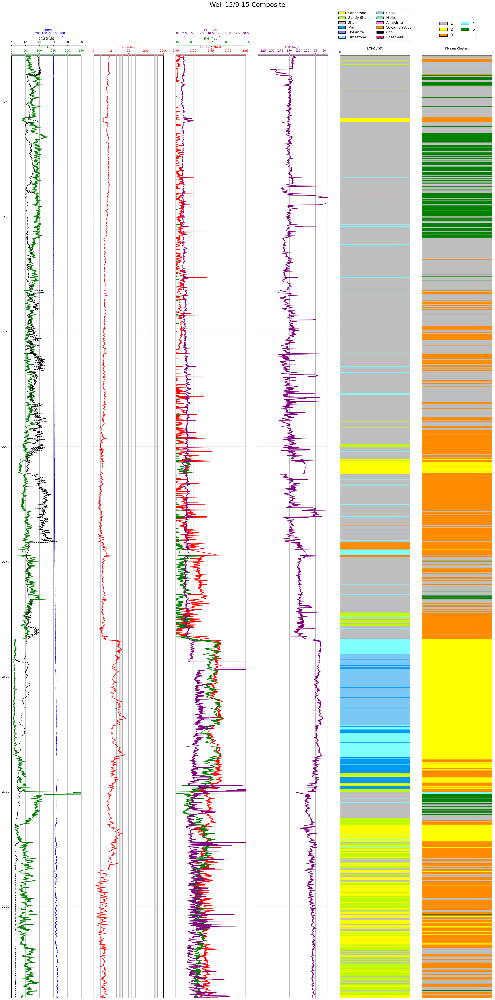

In [327]:
#Display logs for the whole well
triple_combo_plot('15/9-15',well_clustered[well_clustered['WELL'] == '15/9-15'].DEPTH.min(),well_clustered[well_clustered['WELL'] == '15/9-15'].DEPTH.max())

In [ ]:
#Display logs for the whole well
for i, wellname in enumerate (well_clustered['WELL'].unique()):
    well_plot = triple_combo_plot(wellname,well_clustered[well_clustered['WELL'] == wellname].DEPTH.min(),well_clustered[well_clustered['WELL'] == wellname].DEPTH.max())
    well_name = wellname.replace('/', '-')
    plt.savefig('../improving-lithology-label-well-logs/Clustered well plot/Composite_clustered_well_{}.png'.format(well_name),bbox_inches='tight')
    plt.close()

## Crossplots (not used)


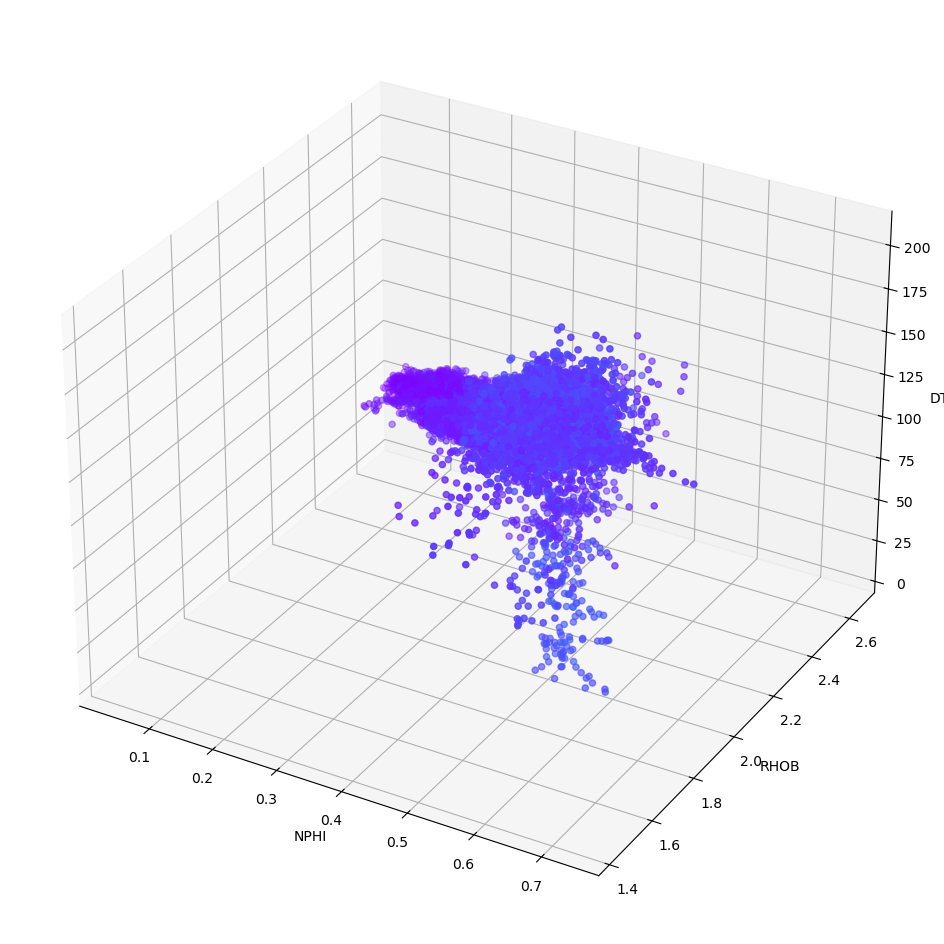

In [15]:
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111, projection="3d")

ax.scatter(well_ex["NPHI"], well_ex["RHOB"], well_ex["DTC"], c=well_ex['GR'], cmap='rainbow')
ax.set_xlabel('NPHI')
ax.set_ylabel('RHOB')
ax.set_zlabel('DT')

plt.show()

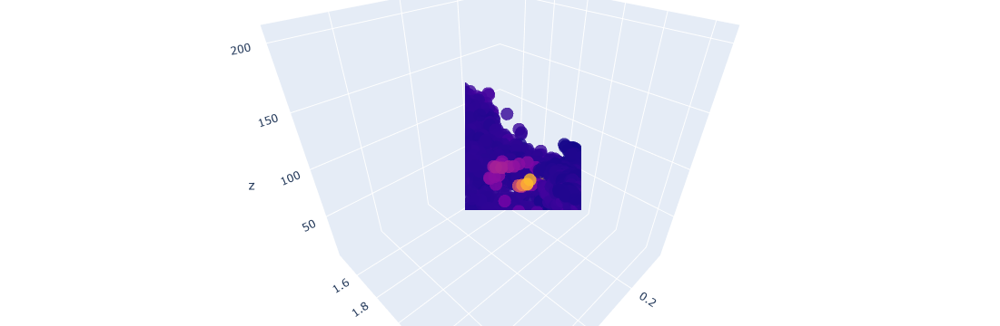

In [11]:
fig = go.Figure(data=[go.Scatter3d(
    x=well_ex["NPHI"],
    y=well_ex["RHOB"],
    z=well_ex["DTC"],
    mode='markers',
    marker=dict(
        size=8,
        color=well_ex["GR"],                # set color to an array/list of desired values
        opacity=0.8
    )
)])

# tight layout
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()

C:\Users\V330\AppData\Local\Temp\ipykernel_10296\2642995227.py:31: UserWarning:

The figure layout has changed to tight



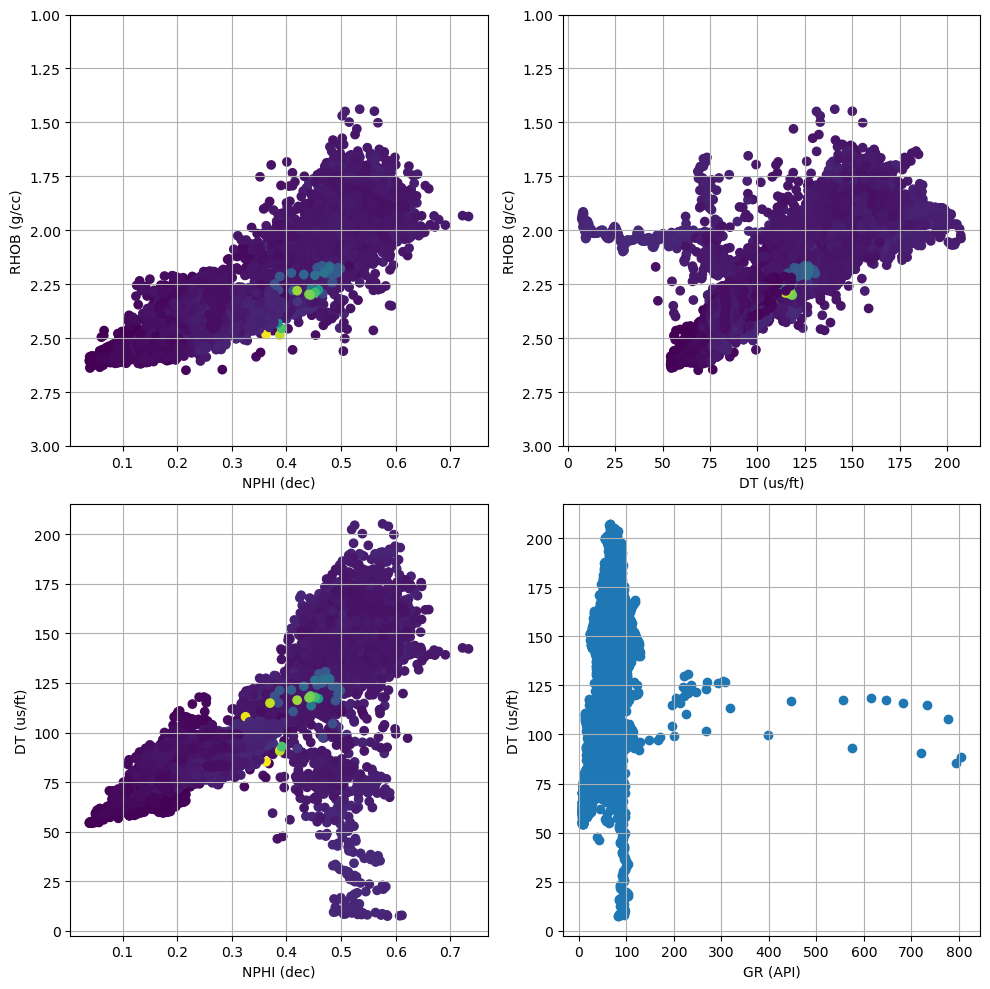

In [22]:
fig = plt.figure(figsize=(10, 10), layout="constrained")
spec = fig.add_gridspec(ncols=2, nrows=2)

ax1 = fig.add_subplot(spec[0, 0])
ax1.scatter(x= "NPHI", y= "RHOB", c = 'GR', data= well_ex, vmin)
ax1.set_ylim(3, 1)
ax1.set_ylabel("RHOB (g/cc)")
ax1.set_xlabel("NPHI (dec)")
ax1.grid(True)

ax2 = fig.add_subplot(spec[1, 0])
ax2.scatter(x= "NPHI", y= "DTC", c = 'GR', data= well_ex)
ax1.set_ylim(3, 1)
ax2.set_ylabel("DT (us/ft)")
ax2.set_xlabel("NPHI (dec)")
ax2.grid(True)

ax3 = fig.add_subplot(spec[0, 1])
ax3.scatter(x= "DTC", y= "RHOB", c = 'GR', data= well_ex)
ax3.set_ylim(3, 1)
ax3.set_ylabel("RHOB (g/cc)")
ax3.set_xlabel("DT (us/ft)")
ax3.grid(True)

ax4 = fig.add_subplot(spec[1, 1])
ax4.scatter(x= "GR", y= "DTC", data= well_ex)
ax4.set_ylabel("DT (us/ft)")
ax4.set_xlabel("GR (API)")
ax4.grid(True)

fig.tight_layout()